# Business Case #1 - Wine store

## Authors:
#### Débora Santos (m20200748), Diana Furtado (m20200590),Pedro Henrique Medeiros (m20200742), Rebeca Pinheiro (m20201096)

#### Group D - D4B Consulting

### Installing and import packages

Maybe it will be necessary install some 'special' packages to this notebook works. 

Please follow the next cells and check if it's necessary

In [ ]:
#Install package pandas profiling to the visualizations
!pip install pandas-profiling

In [ ]:
#Install package to import dataset in excel file
!pip install openpyxl

In [ ]:
#Install package to run Phik correlation
!pip install phik==0.10.0

In [1]:
#IMPORT LIBRARIES
import sqlite3
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns
from datetime import datetime
from sklearn.impute import KNNImputer
from sklearn.cluster import KMeans, AgglomerativeClustering, MeanShift, DBSCAN, estimate_bandwidth
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder, LabelEncoder, RobustScaler
from itertools import product
from math import ceil
from scipy.cluster.hierarchy import dendrogram
%matplotlib inline
from pandas_profiling import ProfileReport 
%config InlineBackend.figure_format = 'retina' 
from scipy.stats import iqr as IQR
from collections import Counter

from sklearn.base import clone
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score, silhouette_samples, davies_bouldin_score
import phik
import matplotlib.cm as cm
from sklearn.manifold import TSNE

#outliers detection
from scipy import stats
from sklearn.neighbors import LocalOutlierFactor
from sklearn import svm
from sklearn.ensemble import IsolationForest
from sklearn.tree import DecisionTreeClassifier

from os.path import join


from sklearn.metrics import pairwise_distances

from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings("ignore")

# Seeting seaborn style
sns.set()

Collect initial data

In [2]:
#import dataset
df = pd.read_excel('WonderfulWinesoftheWorld.xlsx')
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

#### We first look at the excel file and we detected that the last row and last column have formulas contents. We removed it because it can distor the analysis

In [3]:
#Remove the last row and last column
df = df.iloc[0:10000,0:29]

### Describe, explore and assess data quality

In [4]:
# First look at the dataframe
df.head()

,Custid,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
0,5325.0,653.0,55.0,20.0,78473.0,0.0,0.0,20.0,18.0,826.0,445.0,7.0,67.0,4.0,26.0,2.0,1.0,1.0,36.0,5.0,0,0,0,0,0,0,0,0,0
1,3956.0,1041.0,75.0,18.0,105087.0,0.0,0.0,36.0,33.0,1852.0,539.0,2.0,49.0,0.0,46.0,1.0,3.0,0.0,20.0,4.0,0,0,0,1,0,0,0,0,0
2,3681.0,666.0,18.0,12.0,27984.0,1.0,0.0,4.0,56.0,39.0,-7.0,88.0,4.0,29.0,14.0,32.0,21.0,48.0,60.0,8.0,0,0,0,0,0,0,0,0,0
3,2829.0,1049.0,42.0,16.0,61748.0,1.0,1.0,2.0,46.0,37.0,-6.0,70.0,86.0,1.0,11.0,1.0,1.0,55.0,59.0,7.0,0,0,0,0,0,0,0,1,1
4,8788.0,837.0,47.0,16.0,65789.0,0.0,1.0,2.0,3.0,36.0,4.0,35.0,85.0,0.0,12.0,2.0,1.0,28.0,63.0,6.0,0,0,0,0,0,0,0,0,0


In [5]:
# First look at the dataframe
df.tail()

,Custid,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
9995,1383.0,1132.0,57.0,20.0,81033.0,0.0,1.0,19.0,59.0,776.0,187.0,22.0,78.0,0.0,20.0,1.0,1.0,11.0,27.0,4.0,1,0,0,0,0,1,0,1,0
9996,4070.0,596.0,66.0,15.0,84714.0,0.0,0.0,18.0,45.0,720.0,391.0,5.0,30.0,12.0,36.0,10.0,12.0,13.0,18.0,2.0,0,0,0,0,0,0,0,0,0
9997,7909.0,619.0,18.0,12.0,40466.0,0.0,0.0,3.0,65.0,47.0,5.0,23.0,6.0,24.0,10.0,38.0,22.0,41.0,58.0,5.0,0,0,0,0,0,0,0,0,0
9998,4158.0,1107.0,33.0,16.0,53661.0,1.0,0.0,1.0,368.0,15.0,2.0,35.0,18.0,13.0,45.0,11.0,13.0,13.0,60.0,6.0,0,0,0,0,0,0,0,0,0
9999,4914.0,979.0,55.0,16.0,94926.0,0.0,1.0,25.0,28.0,1148.0,293.0,7.0,63.0,10.0,13.0,11.0,3.0,4.0,34.0,5.0,0,0,0,0,0,0,0,0,0


In [6]:
# Data types and null values verification
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Custid       10000 non-null  float64
 1   Dayswus      10000 non-null  float64
 2   Age          10000 non-null  float64
 3   Edu          10000 non-null  float64
 4   Income       10000 non-null  float64
 5   Kidhome      10000 non-null  float64
 6   Teenhome     10000 non-null  float64
 7   Freq         10000 non-null  float64
 8   Recency      10000 non-null  float64
 9   Monetary     10000 non-null  float64
 10  LTV          10000 non-null  float64
 11  Perdeal      10000 non-null  float64
 12  Dryred       10000 non-null  float64
 13  Sweetred     10000 non-null  float64
 14  Drywh        10000 non-null  float64
 15  Sweetwh      10000 non-null  float64
 16  Dessert      10000 non-null  float64
 17  Exotic       10000 non-null  float64
 18  WebPurchase  10000 non-null  float64
 19  WebVi

In [7]:
# Summary statistics for all variables
df.describe(include='all').transpose()

,count,mean,std,min,25%,50%,75%,max
Custid,10000.0,6000.5000,2886.895680,1001.0,3500.75,6000.5,8500.25,11000.0
Dayswus,10000.0,898.1020,202.492789,550.0,723.75,894.0,1074.00,1250.0
Age,10000.0,47.9273,17.302721,18.0,33.00,48.0,63.00,78.0
Edu,10000.0,16.7391,1.876375,12.0,15.00,17.0,18.00,20.0
Income,10000.0,69904.3580,27612.233311,10000.0,47642.00,70012.0,92147.00,140628.0
Kidhome,10000.0,0.4188,0.493387,0.0,0.00,0.0,1.00,1.0
Teenhome,10000.0,0.4698,0.499112,0.0,0.00,0.0,1.00,1.0
Freq,10000.0,14.6281,11.969073,1.0,4.00,12.0,24.00,56.0
Recency,10000.0,62.4068,69.874255,0.0,26.00,52.0,78.25,549.0
Monetary,10000.0,622.5552,647.135323,6.0,63.00,383.0,1077.00,3052.0


In [8]:
# Replace possible empty values with NaN
df.replace("", np.nan, inplace=True)

# Function to show missing values and their percentages
def missing_data(df):
    l = []
    for col in df.columns:
        missing = df[col].isnull().sum(axis=0)
        percentage = missing/df.shape[0]
        l.append([col,missing,percentage*100])
        df_missing = pd.DataFrame(l, columns = ['Feature','missing','percentage'])
        df_missing = df_missing.sort_values('missing',axis=0, ascending = False)    
    return df_missing

# Check the percentage of missing values
df_missing = missing_data(df)
df_missing = df_missing[df_missing['missing']>0]
df_missing

,Feature,missing,percentage


In [9]:
# Check duplicated observations
df.loc[df.duplicated(keep=False), :]

,Custid,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend


In [10]:
# Define non-metric features
non_metric_features = ['SMRack','LGRack','Humid','Spcork','Bucket','Complain','Mailfriend','Emailfriend','Kidhome','Teenhome']

# Make a copy of the dataframe
df1 = df.copy()

# Define metric features
metric_features = df1.columns.drop(non_metric_features).to_list()

### Visualization/Correlations

In [11]:
#PANDAS PROFILING.

ProfileReport(df1)

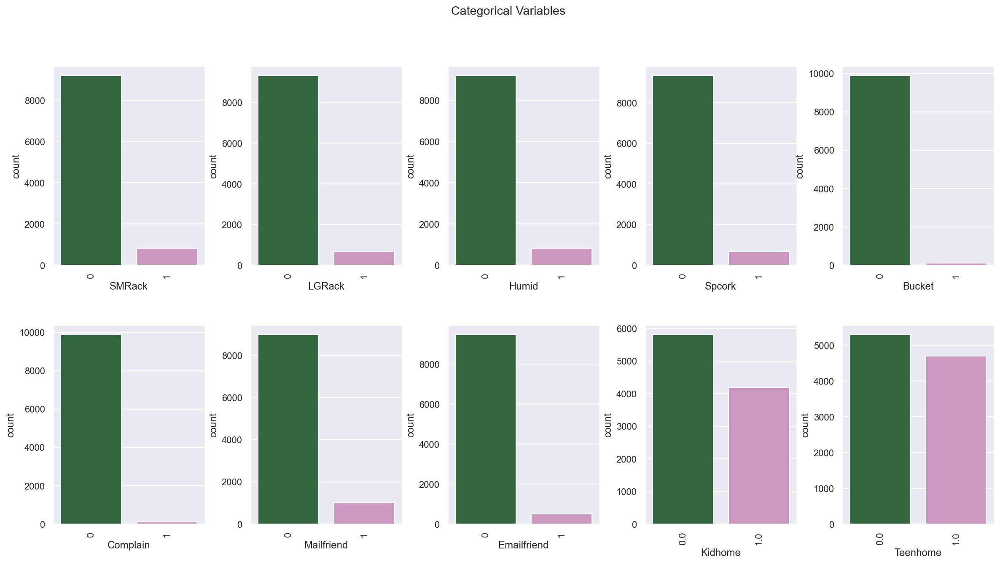

In [12]:
# Absolute frequencies for the non-metric features
sns.set()

# Prepare figure. Create individual axes where each bar plot will be placed
fig, axes = plt.subplots(2, ceil(len(non_metric_features) / 2), figsize=(20, 10))

# Plot data
# Iterate across axes objects and associate each bar plot
for ax, feat in zip(axes.flatten(), non_metric_features):
    g = sns.countplot(df1[feat], ax=ax, palette = 'cubehelix')
    g.set_xticklabels(g.get_xticklabels(),rotation=90)

# Layout
# Add a centered title to the figure:
title = "Categorical Variables"
plt.suptitle(title)

#Adjust the space between plots
plt.subplots_adjust(wspace=0.3, hspace=0.3)

#Show plot

plt.show()

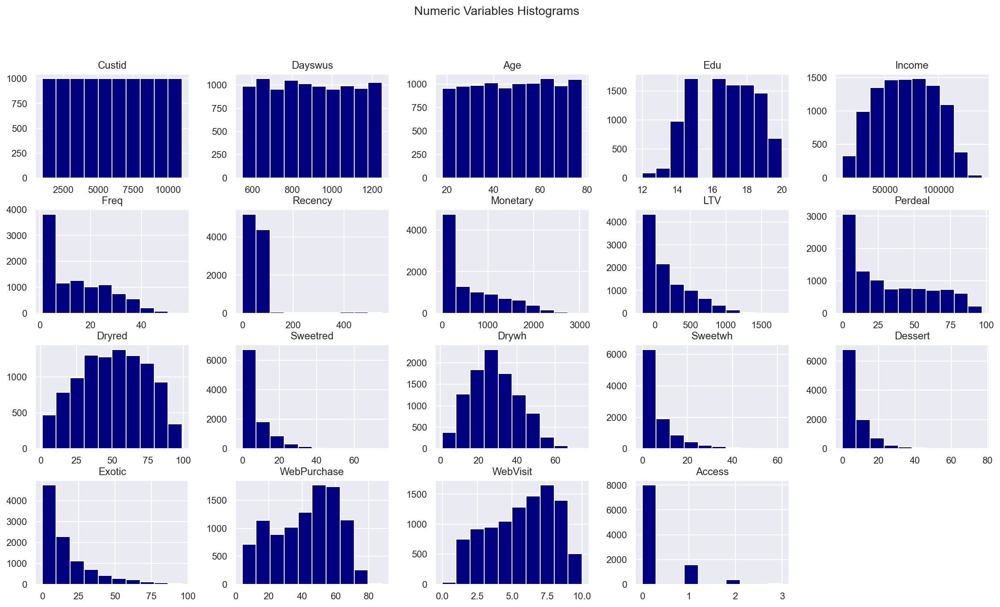

In [13]:
# Histograms for the metric features
sns.set()

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(4, ceil(len(metric_features) / 4), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram:
for ax, feat in zip(axes.flatten(), metric_features): 
    ax.hist(df1[feat], color = "Navy")
    ax.set_title(feat)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables Histograms"
plt.suptitle(title)

#Adjust the space between plots
plt.subplots_adjust(wspace=0.3, hspace=0.3)

# Remove the last plot
axes.flatten()[-1].remove()

#Show Plot
plt.show()

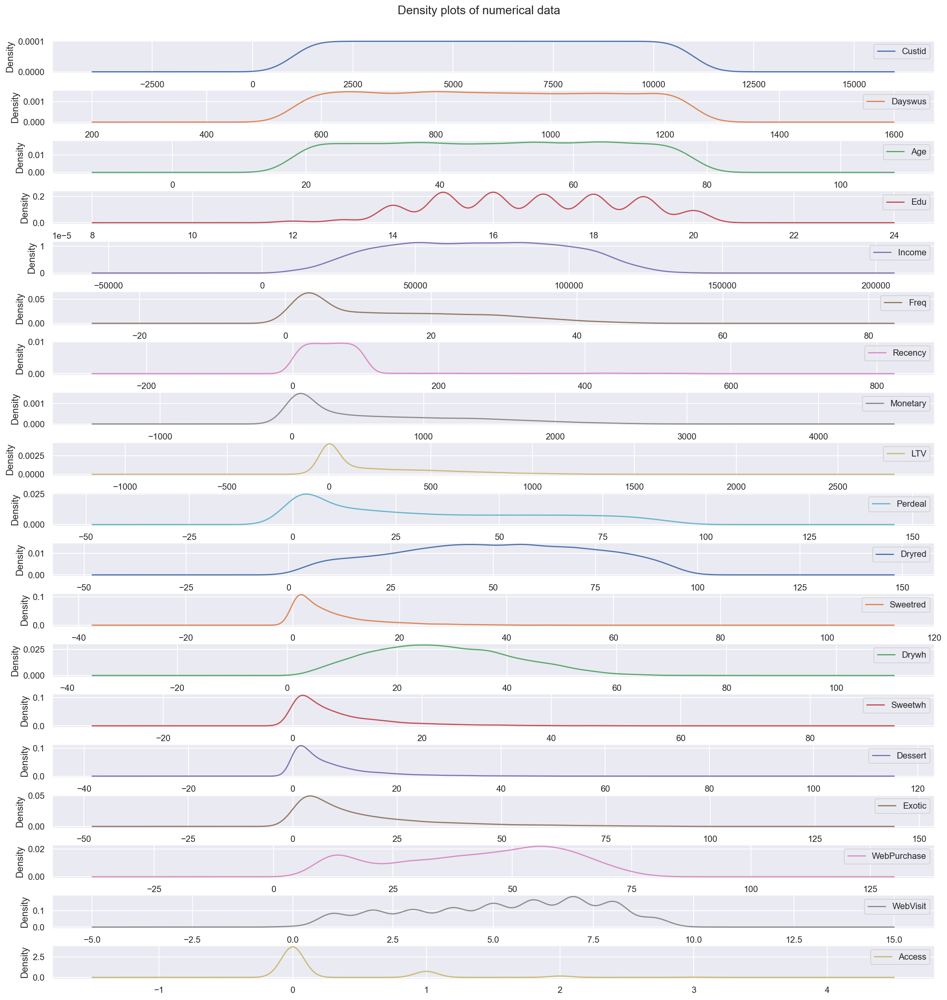

In [14]:
# Density plots for the metric features
sns.set()

# set desity plot and layout
df1[metric_features].plot(kind='density', subplots=True, figsize=(20,20),sharex=False)
plt.subplots_adjust(top=0.95)

# Layout
# Add a centered title to the figure:

plt.suptitle("Density plots of numerical data", fontsize=15)

#Adjust the space between plots
plt.subplots_adjust(hspace=0.5)

#Show Plot
plt.show()

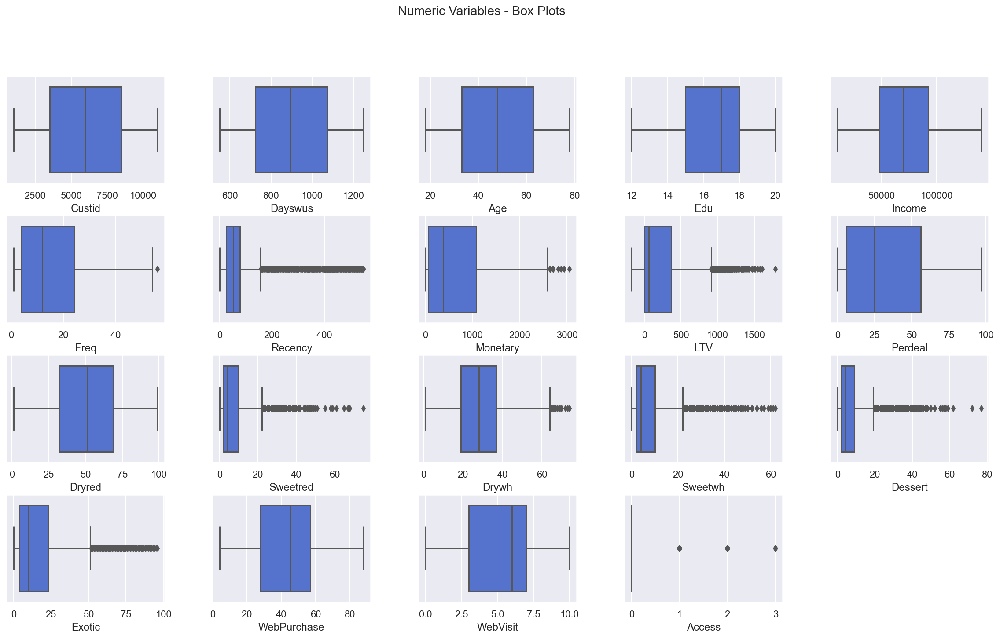

In [15]:
# Boxplots for the metric features
sns.set()

# Prepare figure and create individual axes where each box plot will be placed
fig, axes = plt.subplots(4, ceil(len(metric_features) /4), figsize=(20, 11))

# Plot the data
# Iterate across axes objects and associate each box plot
for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(df1[feat], ax=ax,color="royalblue")
    
# Layout
# Add a centered title to the figure
title = "Numeric Variables - Box Plots"
plt.suptitle(title)

# Adjust the space between plots
plt.subplots_adjust(wspace=0.3, hspace=0.3)

# Remove the last plot
axes.flatten()[-1].remove()

# Show plots
plt.show()

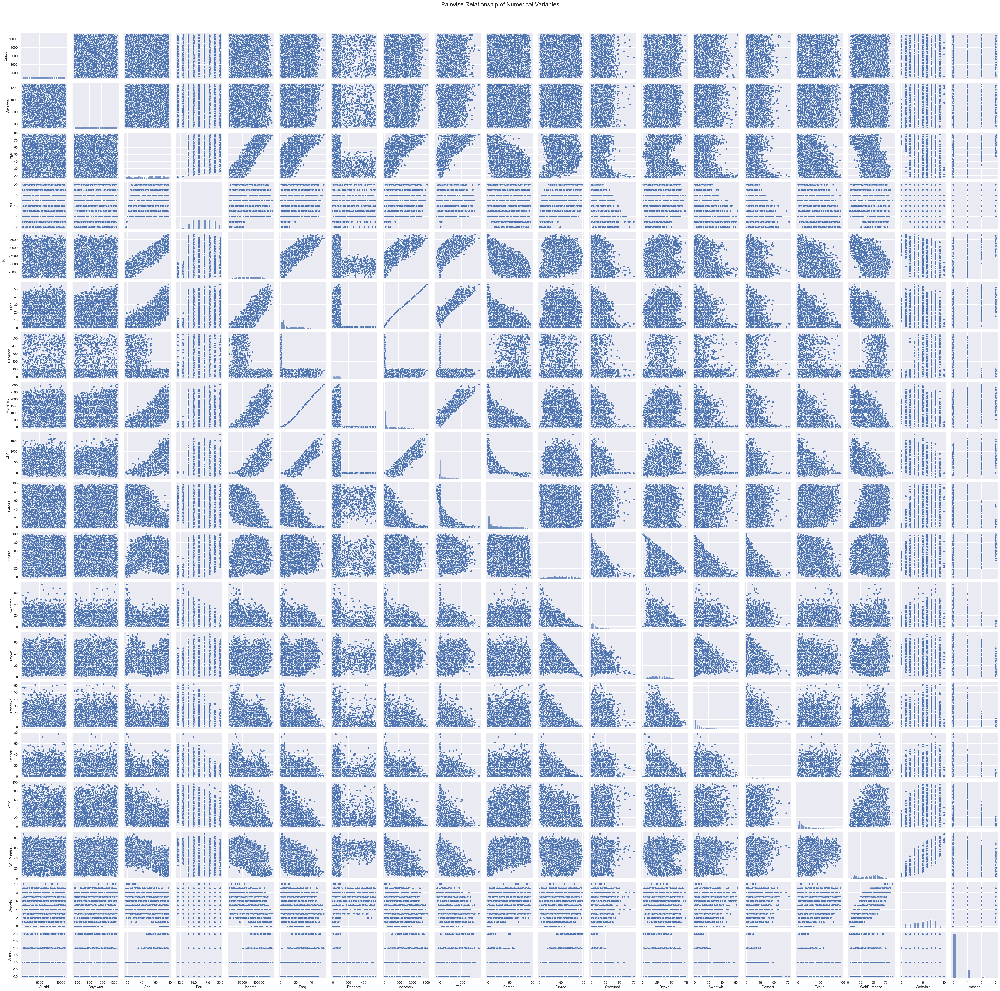

In [16]:
# Pairwise relationship of metric features
sns.set()

# Setting pairplot
sns.pairplot(data=df1[metric_features], diag_kind="hist")

# Layout
# Add a centered title to the figure
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

# Show plots
plt.show()

### Correlation

#### In order to perform clustering is useless and harmful to keep variables that are either highly or lowly correlated with each other. In the first case because it leads to redudancy of the data, the second because lowly correlated columns will have tha same value among all the clusters and give no information to our cluster analysis.

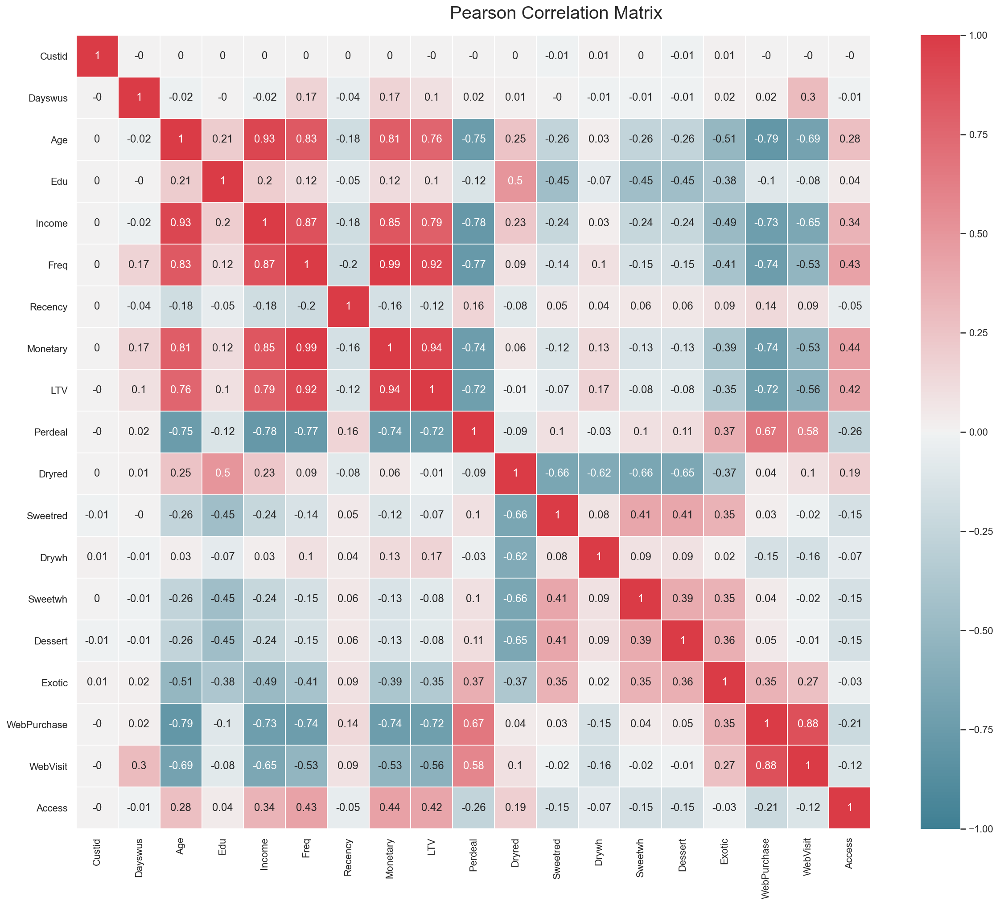

In [17]:
# Pearson Correlation matrix

# Set correlation matrix
correlation = np.round(df1[metric_features].corr(),2)
## Set layout
fig = plt.figure(figsize=(20, 15))
sns.heatmap(data=correlation, annot = correlation.values,cmap=sns.diverging_palette(220, 10, as_cmap=True), 
             vmin=-1, vmax=1, center=0, square=True, linewidths=.5)
fig.subplots_adjust(top=0.95)
fig.suptitle("Pearson Correlation Matrix", fontsize=20)

plt.show()

#### The next cell, we re-run the pearson correlation matrix after drop the variables high correlated

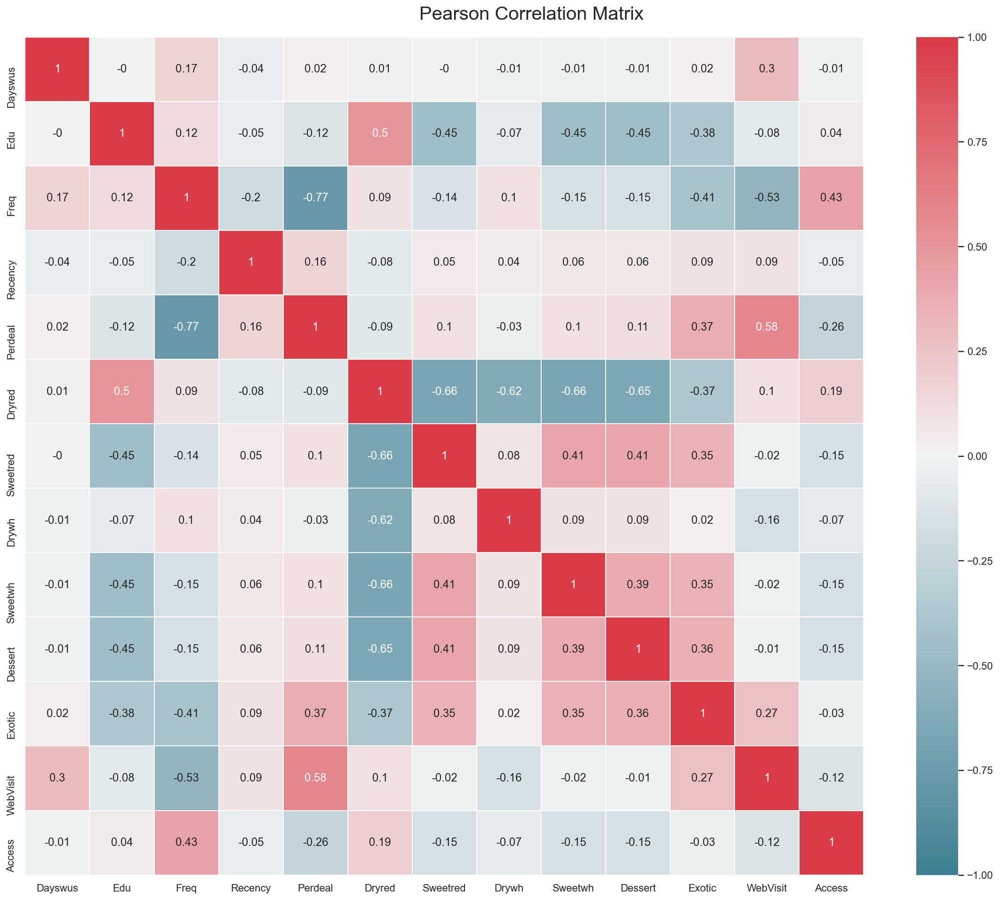

In [18]:
#Define metric features to re-run the Pearson correlation matrix
metric_features2 = ['Dayswus','Edu','Freq','Recency', 'Perdeal','Dryred', 'Sweetred','Drywh','Sweetwh','Dessert',
                   'Exotic', 'WebVisit','Access']

# Pearson Correlation matrix
# Set correlation matrix
correlation = np.round(df1[metric_features2].corr(),2)
## Set layout
fig = plt.figure(figsize=(20, 15))
sns.heatmap(data=correlation, annot = correlation.values,cmap=sns.diverging_palette(220, 10, as_cmap=True), 
             vmin=-1, vmax=1, center=0, square=True, linewidths=.5)
fig.subplots_adjust(top=0.95)
fig.suptitle("Pearson Correlation Matrix", fontsize=20)

plt.show()

#### We ran the Phi-k correlation, but we decide to not drop any collumn based on that. We are dealing with a cluster problem and the categorical values will be excluded at the time of run the model. 

interval columns not set, guessing: ['Freq', 'Recency', 'Edu', 'Dayswus', 'Access', 'Perdeal', 'SMRack', 'LGRack', 'Humid', 'Spcork', 'Bucket', 'Complain', 'Mailfriend', 'Emailfriend', 'Kidhome', 'Teenhome']


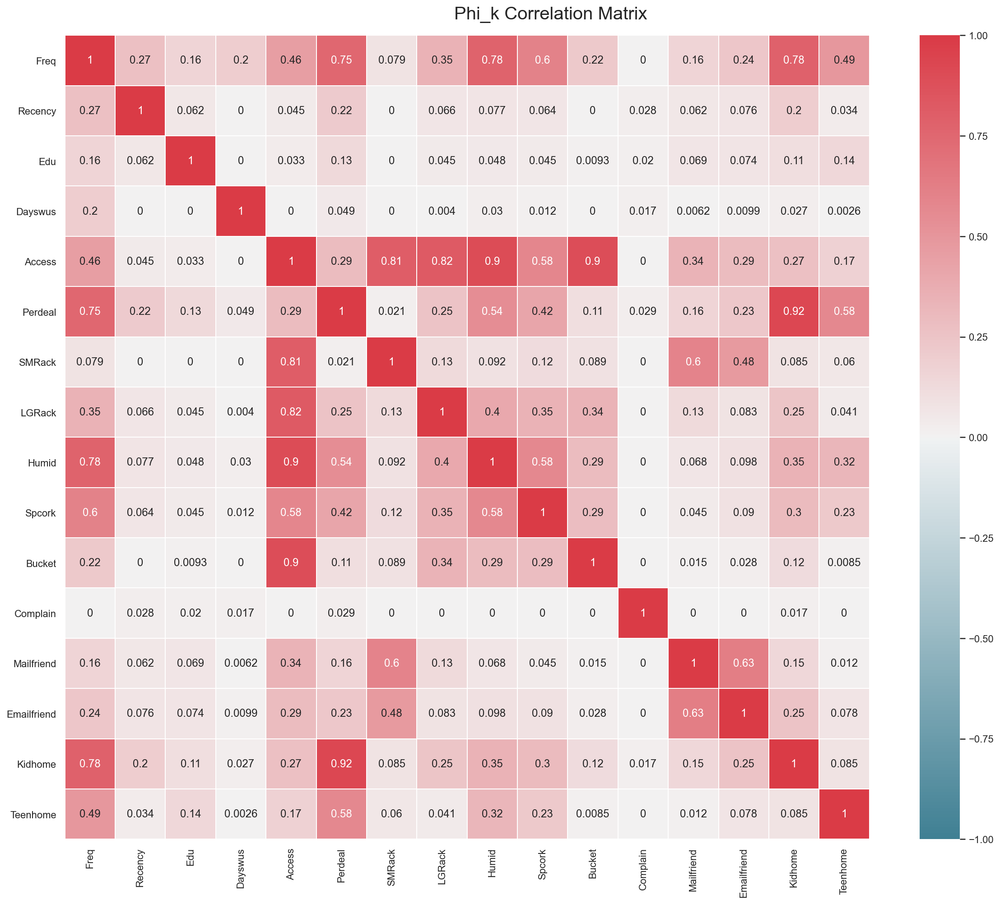

In [19]:
# Define features for Phi_K correlation
corr_features =["Freq", "Recency", "Edu",'Dayswus','Access','Perdeal','SMRack','LGRack','Humid','Spcork','Bucket', 'Complain',
                'Mailfriend','Emailfriend','Kidhome','Teenhome']
# Set correlation matrix
correlation2 = df1[corr_features].phik_matrix()
# Set layout
fig = plt.figure(figsize=(20, 15))
sns.heatmap(correlation2, annot = correlation2.values, cmap=sns.diverging_palette(220, 10, as_cmap=True),
            vmin=-1, vmax=1, center=0, square=True, linewidths=.5)
fig.subplots_adjust(top=0.95)
fig.suptitle("Phi_k Correlation Matrix", fontsize=20)

plt.show()

## Data Preparation:

In [20]:
#Set index
df1= df1.set_index('Custid')

### Feature Engineering

In [21]:
#Create a new variable that calculates the average price of purchases (average ticket).
#Calculate by dividing monetary bt frequency
df1['Avg_ticket'] = np.round(df1['Monetary']/df1['Freq'],2)

### Clean data

In [22]:
# Dropping duplicated rows
df1.drop_duplicates(inplace=True)
# Check results
df1.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 10000 entries, 5325.0 to 4914.0
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Dayswus      10000 non-null  float64
 1   Age          10000 non-null  float64
 2   Edu          10000 non-null  float64
 3   Income       10000 non-null  float64
 4   Kidhome      10000 non-null  float64
 5   Teenhome     10000 non-null  float64
 6   Freq         10000 non-null  float64
 7   Recency      10000 non-null  float64
 8   Monetary     10000 non-null  float64
 9   LTV          10000 non-null  float64
 10  Perdeal      10000 non-null  float64
 11  Dryred       10000 non-null  float64
 12  Sweetred     10000 non-null  float64
 13  Drywh        10000 non-null  float64
 14  Sweetwh      10000 non-null  float64
 15  Dessert      10000 non-null  float64
 16  Exotic       10000 non-null  float64
 17  WebPurchase  10000 non-null  float64
 18  WebVisit     10000 non-null  float64
 

In [23]:
# Remove columns with low variance -> feature is approximately constant and will not improve the performance of the model 
# Features with variance lower to 10% will be removed

# Select features with variance higher then 10%
keep_variance_features = df1.columns[df1.var() > 0.1]

# Features with low variance
low_variance_features = list(set(keep_variance_features) ^set(df1.columns))
print("the features variance lower than 10% are:")
print(low_variance_features)

# Check result
df1[keep_variance_features]

the features variance lower than 10% are:
['Spcork', 'Complain', 'Mailfriend', 'Bucket', 'LGRack', 'Humid', 'Emailfriend', 'SMRack']


,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access,Avg_ticket
Custid,,,,,,,,,,,,,,,,,,,,,
5325.0,653.0,55.0,20.0,78473.0,0.0,0.0,20.0,18.0,826.0,445.0,7.0,67.0,4.0,26.0,2.0,1.0,1.0,36.0,5.0,0,41.30
3956.0,1041.0,75.0,18.0,105087.0,0.0,0.0,36.0,33.0,1852.0,539.0,2.0,49.0,0.0,46.0,1.0,3.0,0.0,20.0,4.0,0,51.44
3681.0,666.0,18.0,12.0,27984.0,1.0,0.0,4.0,56.0,39.0,-7.0,88.0,4.0,29.0,14.0,32.0,21.0,48.0,60.0,8.0,0,9.75
2829.0,1049.0,42.0,16.0,61748.0,1.0,1.0,2.0,46.0,37.0,-6.0,70.0,86.0,1.0,11.0,1.0,1.0,55.0,59.0,7.0,0,18.50
8788.0,837.0,47.0,16.0,65789.0,0.0,1.0,2.0,3.0,36.0,4.0,35.0,85.0,0.0,12.0,2.0,1.0,28.0,63.0,6.0,0,18.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383.0,1132.0,57.0,20.0,81033.0,0.0,1.0,19.0,59.0,776.0,187.0,22.0,78.0,0.0,20.0,1.0,1.0,11.0,27.0,4.0,1,40.84
4070.0,596.0,66.0,15.0,84714.0,0.0,0.0,18.0,45.0,720.0,391.0,5.0,30.0,12.0,36.0,10.0,12.0,13.0,18.0,2.0,0,40.00
7909.0,619.0,18.0,12.0,40466.0,0.0,0.0,3.0,65.0,47.0,5.0,23.0,6.0,24.0,10.0,38.0,22.0,41.0,58.0,5.0,0,15.67


#### The variance metric only detect categorical variables with low variances. As we are dealing with a cluster problem, we will not drop these columns now. They will be drop before run the model. 

In [24]:
# Droping the variables with high correlation
df1.drop(['Monetary', 'Income', "Age",'WebPurchase','LTV'], axis=1, inplace=True)

In [25]:
#re-define non_metric and metric due to drop columns
non_metric_features = ['SMRack','LGRack','Spcork','Bucket','Humid','Complain','Mailfriend','Emailfriend','Kidhome','Teenhome']
metric_features = df1.columns.drop(non_metric_features).to_list()


In [26]:
#Check the size of dataset
df1.shape

(10000, 24)

In [27]:
#Look at the data
df1.head()

,Dayswus,Edu,Kidhome,Teenhome,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,Avg_ticket
Custid,,,,,,,,,,,,,,,,,,,,,,,,
5325.0,653.0,20.0,0.0,0.0,20.0,18.0,7.0,67.0,4.0,26.0,2.0,1.0,1.0,5.0,0,0,0,0,0,0,0,0,0,41.30
3956.0,1041.0,18.0,0.0,0.0,36.0,33.0,2.0,49.0,0.0,46.0,1.0,3.0,0.0,4.0,0,0,0,1,0,0,0,0,0,51.44
3681.0,666.0,12.0,1.0,0.0,4.0,56.0,88.0,4.0,29.0,14.0,32.0,21.0,48.0,8.0,0,0,0,0,0,0,0,0,0,9.75
2829.0,1049.0,16.0,1.0,1.0,2.0,46.0,70.0,86.0,1.0,11.0,1.0,1.0,55.0,7.0,0,0,0,0,0,0,0,1,1,18.50
8788.0,837.0,16.0,0.0,1.0,2.0,3.0,35.0,85.0,0.0,12.0,2.0,1.0,28.0,6.0,0,0,0,0,0,0,0,0,0,18.00


### Dealing with Outliers

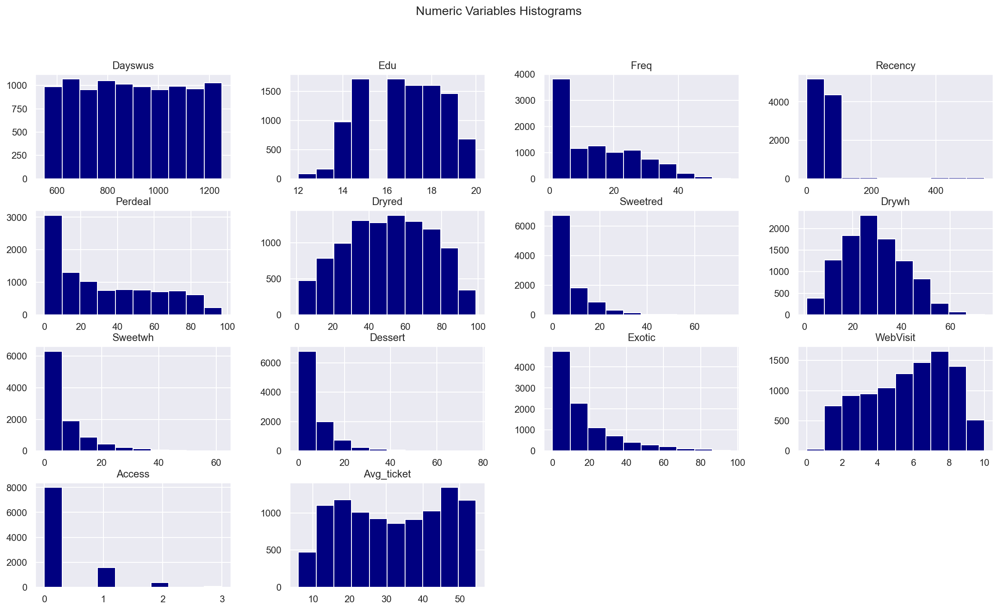

In [28]:
# Histograms for the metric features
sns.set()

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(4, ceil(len(metric_features) / 4), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram:
for ax, feat in zip(axes.flatten(), metric_features): 
    ax.hist(df1[feat], color = "Navy")
    ax.set_title(feat)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables Histograms"
plt.suptitle(title)
#Adjust the space between plots
plt.subplots_adjust(wspace=0.3, hspace=0.3)

# Remove the last  2 plots
axes.flatten()[-1].remove()
axes.flatten()[-2].remove()

#Show Plot
plt.show()

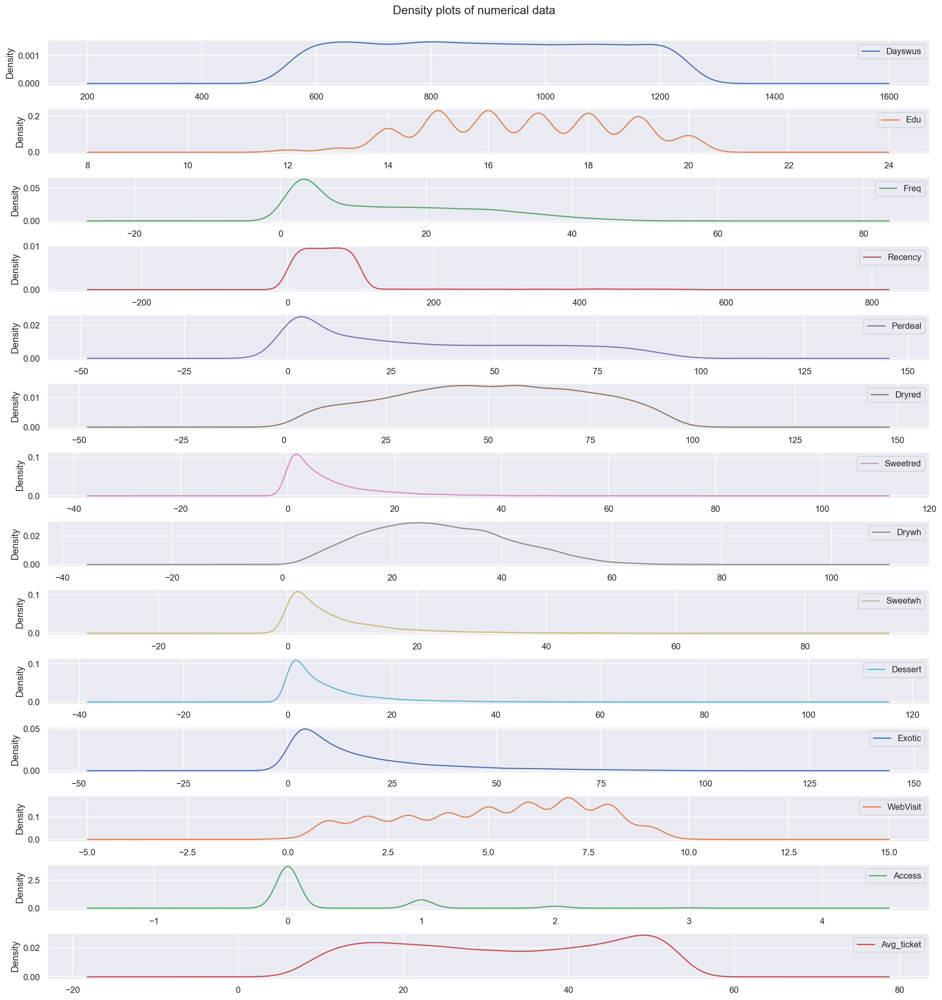

In [29]:
# Density plots for the metric features
sns.set()

# set desity plot and layout
df1[metric_features].plot(kind='density', subplots=True, figsize=(20,20),sharex=False)
plt.subplots_adjust(top=0.95)
plt.suptitle("Density plots of numerical data", fontsize=15)
#Adjust the space between plots
plt.subplots_adjust(hspace=0.5)
plt.show()

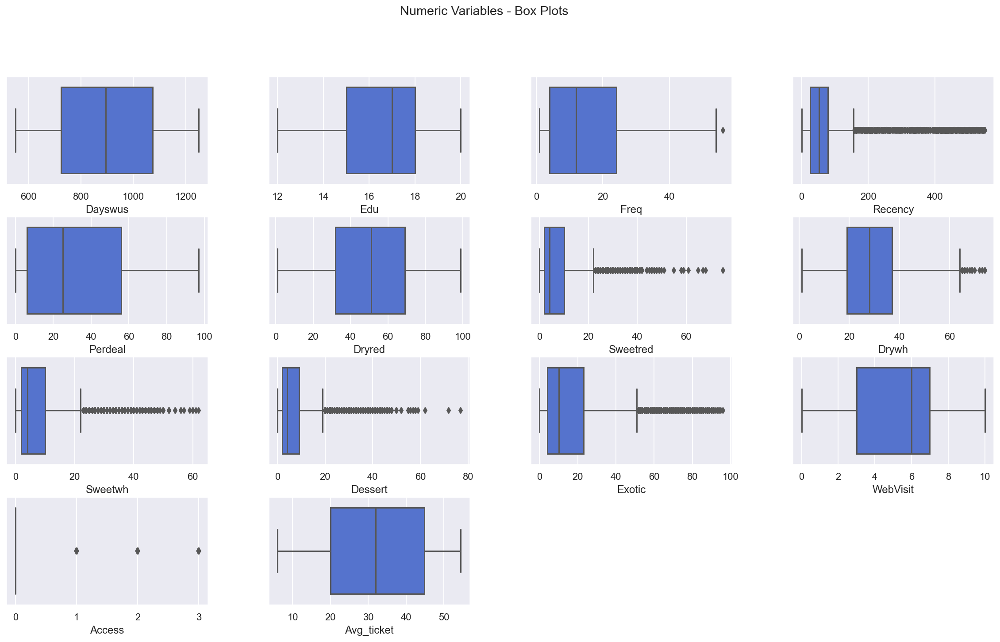

In [30]:
# Boxplots for the metric features
sns.set()

# Prepare figure and create individual axes where each box plot will be placed
fig, axes = plt.subplots(4, ceil(len(metric_features) /4), figsize=(20, 11))

# Plot the data
# Iterate across axes objects and associate each box plot
for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(df1[feat], ax=ax,color="royalblue")
    
# Layout
# Add a centered title to the figure
title = "Numeric Variables - Box Plots"

plt.suptitle(title)

# Adjust the space between plots
plt.subplots_adjust(wspace=0.3, hspace=0.3)

# Remove the last  2 plots
axes.flatten()[-2].remove()
axes.flatten()[-1].remove()
# Show plots
plt.show()

In [31]:
#Standardize the data to run the outliers methods
#Select data
df1_out = df1[metric_features].copy()
# Create a StandardScaler
scale = StandardScaler()
# Fit and Transform data by applying the scale obtained in the previous command
scale_feat= scale.fit_transform(df1_out[metric_features])
#Applying the transformation in the dataset
df1_out[metric_features]=scale_feat
#Check the results
df1_out.head()

,Dayswus,Edu,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,Access,Avg_ticket
Custid,,,,,,,,,,,,,,
5325.0,-1.210484,1.737959,0.448837,-0.635556,-0.910434,0.708547,-0.388309,-0.200368,-0.632564,-0.754827,-0.901419,-0.092948,-0.456273,0.682528
3956.0,0.705730,0.672021,1.785683,-0.420874,-1.089673,-0.058957,-0.896817,1.389036,-0.757335,-0.500993,-0.959401,-0.522070,-0.456273,1.422115
3681.0,-1.146281,-2.525794,-0.888008,-0.091695,1.993239,-1.977717,2.789865,-1.154011,3.110566,1.783517,1.823723,1.194418,-0.456273,-1.618653
2829.0,0.745239,-0.393917,-1.055114,-0.234816,1.347978,1.518690,-0.769690,-1.392422,-0.757335,-0.754827,2.229595,0.765296,-0.456273,-0.980449
8788.0,-0.301764,-0.393917,-1.055114,-0.850238,0.093305,1.476051,-0.896817,-1.312952,-0.632564,-0.754827,0.664088,0.336174,-0.456273,-1.016918


In [32]:
#Check the statistics summary to check it worked
df1_out.describe().apply(lambda s: s.apply(lambda x:format(x,'g')))

,Dayswus,Edu,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,Access,Avg_ticket
count,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000
mean,1.25133e-16,-3.95517e-16,-2.69784e-17,5.84144e-17,-3.10418e-17,-9.99201e-19,-3.62765e-17,-1.03917e-17,1.71418e-17,-3.20011e-16,-1.90137e-16,2.1475e-16,-6.17761e-16,1.30496e-16
std,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005
min,-1.71917,-2.52579,-1.13867,-0.893175,-1.16137,-2.10563,-0.896817,-2.18712,-0.882106,-0.881745,-0.959401,-2.23856,-0.456273,-1.89217
25%,-0.861071,-0.926887,-0.888008,-0.521059,-0.946282,-0.783822,-0.642563,-0.75666,-0.632564,-0.62791,-0.727474,-0.951192,-0.456273,-0.871042
50%,-0.0202585,0.139052,-0.219585,-0.148944,-0.265173,0.0263211,-0.388309,-0.0414278,-0.383022,-0.374076,-0.379583,0.336174,-0.456273,-0.00162644
75%,0.868706,0.672021,0.783049,0.22675,0.846109,0.793825,0.374453,0.673804,0.365604,0.26051,0.374179,0.765296,-0.456273,0.943645
max,1.73792,1.73796,3.45674,6.96419,2.31587,2.073,8.63771,3.6142,6.8537,8.89088,4.60685,2.05266,5.10803,1.6453


#### We use 6 methods to recognize outliers:

In [33]:
#1) Zscore that checks how many standard deviations is a datapoint distant from the mean;
def out_zscore(df, threshold = 3.0):
    z = pd.DataFrame(np.abs(stats.zscore(df)), columns = df.columns, index = df.index)
    z = pd.DataFrame(z > threshold)
    return z.any(axis = 1).astype(int)

In [34]:
#2) InterQuantile Range method that creates boundaries using the first and thirs quantile and the interquantile range;
def out_iqr(df, multiplier = 3.0):
    q75 = df.quantile(0.75, axis = 0)
    q25 = df.quantile(0.25, axis = 0)
    iqr = q75 - q25
    lower_bound = q25 - multiplier*iqr
    upper_bound = q75 + multiplier*iqr
    return df.apply(lambda x: np.any((x<lower_bound) | (x>upper_bound)), 1).astype(int)

#### 3) Local Outlier Factor (LOF) is a function that detects outliers by comparing the density of the neighborhood of a point to the ones of its neighbors.

In [35]:
lof = LocalOutlierFactor(contamination = 'auto',metric = 'euclidean',n_neighbors=1)
lof_out = pd.Series(lof.fit_predict(df1_out), index = df1_out.index)
lof_out.value_counts(normalize = True)

 1    0.9366
-1    0.0634
dtype: float64

#### 4) At the basis of the Isolation Forest algorithm there is the tendency of anomalous instances in a dataset to be easier to separate from the rest of the sample (isolate), compared to normal points. In order to isolate a data point the algorithm recursively generates partitions on the sample by randomly selecting an attribute and then randomly selecting a split value for the attribute, between the minimum and maximum values allowed for that attribute. When all the trees are grown outliers are identified as points easier to isolate, therefore with a smaller path lenght in the tree, being closer to the root.

In [36]:
isolation_forest = IsolationForest(random_state = 7, contamination=  "auto")
isolation_forest.fit(df1_out) #same results with scaled
isofor_outliers = pd.Series(isolation_forest.predict(df1_out), index = df1_out.index)
isofor_outliers.value_counts(normalize = True)

 1    0.8337
-1    0.1663
dtype: float64

#### 5) One-Class SVM is similar to support vector machine, but instead of using a hyperplane to separate two classes of instances, it uses a hypersphere to encompass all of the instances. The algorithm will try to find the smallest possible hypersphere and point outside of it will be considered outliers. One bad thing of this algorithm is that you have to set in advance the percentage of points that you think are outliers, in this case I use the one retrieved from LOF.

In [37]:
outliers_fraction =   0.063
auto_detection = svm.OneClassSVM(kernel='rbf', gamma=0.01, degree=3, nu=outliers_fraction)
auto_detection.fit(df1_out)
svm_outliers = pd.Series(auto_detection.predict(df1_out), index = df1_out.index)
svm_outliers.value_counts(normalize = True)

 1    0.9368
-1    0.0632
dtype: float64

#### 6) DBSCAN set a point p and the density around a point can be measured by the number of points surrounding it. To measure the density around a point p, it used the topological definition of neighborhood. The 𝜀-neighborhood of a point p is the space within a radius 𝜀 > 0 centered in p. For this algorithm, it's necessary set the minimal number of points in each neighborhood (min_samples) and the size of the radius (area) of neighborhood (eps). It's considered a core point when a point there is at least the minimal points around it into your radius. Not core points are points inside the radium of a core point, but they don't have the minimal number of points around them. The noise point are points they are neither a core point and not core point. We are interest in this analyse to detect the noise points. The 2 plots bellow are to find the eps to run the dbscan algorithm.  

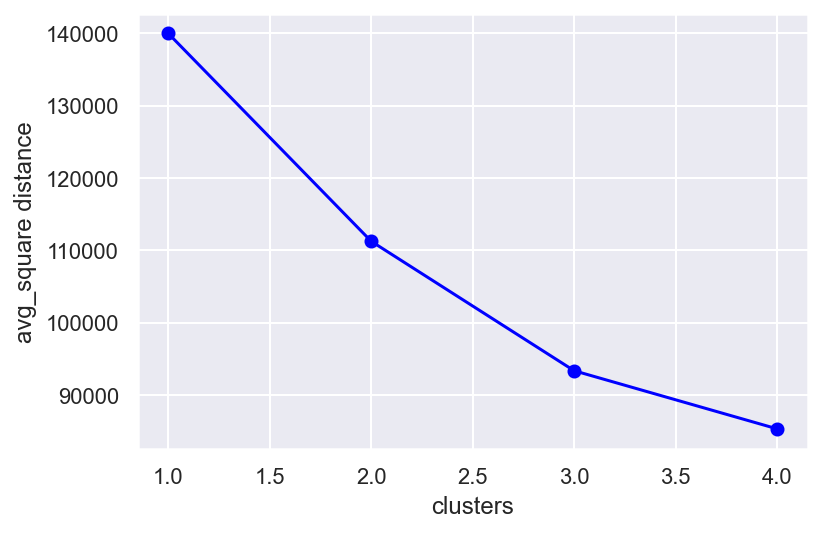

In [38]:
#Elbow plot to find the number of neighbors
inert = []
K = range(1,5)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(df1_out)
    inert.append(kmeanModel.inertia_)
#Define name for x axis and y axis
plt.xlabel("clusters")
plt.ylabel("avg_square distance")
plt.plot(K,inert,"o-",color="blue")

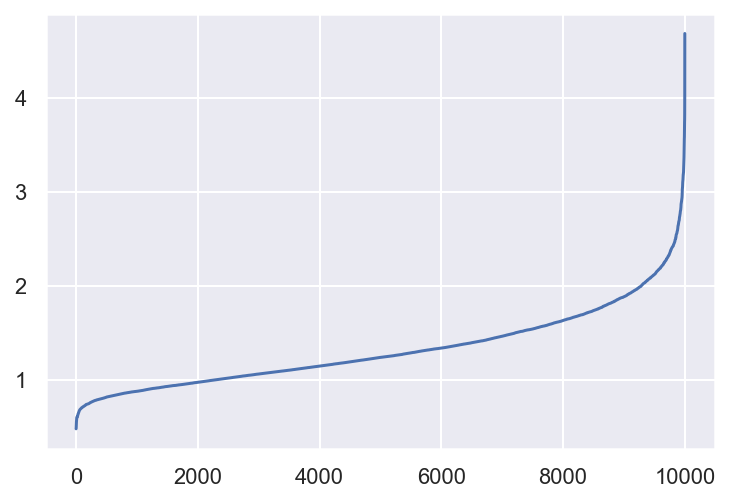

In [39]:
# K-distance graph to find out the right eps value
#Use the number of neighbors detect in the elbow plot. 
neigh = NearestNeighbors(n_neighbors=3)
neigh.fit(df1_out)
distances, _ = neigh.kneighbors(df1_out)
distances = np.sort(distances[:, -1])
plt.plot(distances)
# plt.subplot(1.1,figsize=(20,15))
plt.figure(1, figsize=(20, 10))
plt.show()

In [40]:
#After find the eps value, we run the DBSCAN algorithm
dbscan = DBSCAN(eps=2.5, min_samples=20, n_jobs=-1)
dbscan_labels = dbscan.fit_predict(df1_out)
dbscan_outliers = pd.Series(dbscan.fit_predict(df1_out), index = df1_out.index)
dbscan_outliers.value_counts(normalize = True)

 0    0.9707
-1    0.0293
dtype: float64

In [41]:
#Including columns with the results of each method in the dataset to compare the different methods and also combine them.
df1_out['zscore'] = out_zscore(df1_out)

df1_out['iqr'] = out_iqr(df1_out, multiplier = 3.0)

df1_out['lof_out'] = [0 for i in range(len(df1_out))]
df1_out.loc[lof_out[lof_out == -1].index, 'lof_out'] = 1

df1_out['isofor_out'] = [0 for i in range(len(df1_out))]
df1_out.loc[isofor_outliers[isofor_outliers == -1].index, 'isofor_out'] = 1

df1_out['svm_out'] = [0 for i in range(len(df1_out))]
df1_out.loc[svm_outliers[svm_outliers == -1].index, 'svm_out'] = 1

df1_out['dbscan_out'] = [0 for i in range(len(df1_out))]
df1_out.loc[dbscan_outliers[dbscan_outliers != -1].index, 'dbscan_out'] = 0
df1_out.loc[dbscan_outliers[dbscan_outliers == -1].index, 'dbscan_out'] = 1

df1_out['sum_out']  = df1_out[['zscore','iqr','svm_out','lof_out','isofor_out','dbscan_out']].apply(lambda x: sum(x), axis = 1)

In [42]:
#Create a dataset for see the outliers detect by each model
outliers = df1_out[['zscore','iqr','svm_out','lof_out','isofor_out','dbscan_out']]
outliers.groupby(['zscore','iqr','svm_out','lof_out','isofor_out','dbscan_out'])\
            .size()\
            .to_frame()

0
zscore iqr svm_out lof_out isofor_out dbscan_out      
0      0   0       0       0          0           6366
                                      1              1
                           1          0            308
                                      1              2
                   1       0          0            368
                           1          0             33
                                      1              2
           1       0       0          0             49
                           1          0             16
                   1       0          0              3
                           1          0              4
       1   0       0       0          0           1139
                           1          0            203
                                      1             21
                   1       0          0             83
                           1          0             26
                                      1              4
           1       0       0          0              1
                           1          0             13
                   1       1          0              3
1      1   0       0       0          0            287
                                      1              2
                           1          0            405
                                      1             56
                   1       0          0             17
                                      1              1
                           1          0             28
                                      1             16
           1       0       0          0             16
                                      1              2
                           1          0            316
                                      1            163
                   1       0          0              2
                           1          0             21
                                      1             23

In [43]:
#Show the number of outliers detect by z-score individually
df1_out['zscore'].value_counts()

0    8645
1    1355
Name: zscore, dtype: int64

In [44]:
#Show the number of outliers detect by IQR individually
df1_out['iqr'].value_counts()

0    7152
1    2848
Name: iqr, dtype: int64

In [45]:
#Show the number of outliers detect by combined methods. 
df1_out['sum_out'].value_counts()

0    6366
1    1865
2     628
3     506
4     412
5     200
6      23
Name: sum_out, dtype: int64

In [46]:
#Chose the number 4 with the best possible solution of combined methods
df1_out2 = df1.loc[df1_out.query('sum_out == 4').index]
df2 = df1.drop(index = df1_out.query('sum_out == 4').index)

In [47]:
#Look at the results
df2

,Dayswus,Edu,Kidhome,Teenhome,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,Avg_ticket
Custid,,,,,,,,,,,,,,,,,,,,,,,,
5325.0,653.0,20.0,0.0,0.0,20.0,18.0,7.0,67.0,4.0,26.0,2.0,1.0,1.0,5.0,0,0,0,0,0,0,0,0,0,41.30
3956.0,1041.0,18.0,0.0,0.0,36.0,33.0,2.0,49.0,0.0,46.0,1.0,3.0,0.0,4.0,0,0,0,1,0,0,0,0,0,51.44
3681.0,666.0,12.0,1.0,0.0,4.0,56.0,88.0,4.0,29.0,14.0,32.0,21.0,48.0,8.0,0,0,0,0,0,0,0,0,0,9.75
2829.0,1049.0,16.0,1.0,1.0,2.0,46.0,70.0,86.0,1.0,11.0,1.0,1.0,55.0,7.0,0,0,0,0,0,0,0,1,1,18.50
8788.0,837.0,16.0,0.0,1.0,2.0,3.0,35.0,85.0,0.0,12.0,2.0,1.0,28.0,6.0,0,0,0,0,0,0,0,0,0,18.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383.0,1132.0,20.0,0.0,1.0,19.0,59.0,22.0,78.0,0.0,20.0,1.0,1.0,11.0,4.0,1,0,0,0,0,1,0,1,0,40.84
4070.0,596.0,15.0,0.0,0.0,18.0,45.0,5.0,30.0,12.0,36.0,10.0,12.0,13.0,2.0,0,0,0,0,0,0,0,0,0,40.00
7909.0,619.0,12.0,0.0,0.0,3.0,65.0,23.0,6.0,24.0,10.0,38.0,22.0,41.0,5.0,0,0,0,0,0,0,0,0,0,15.67


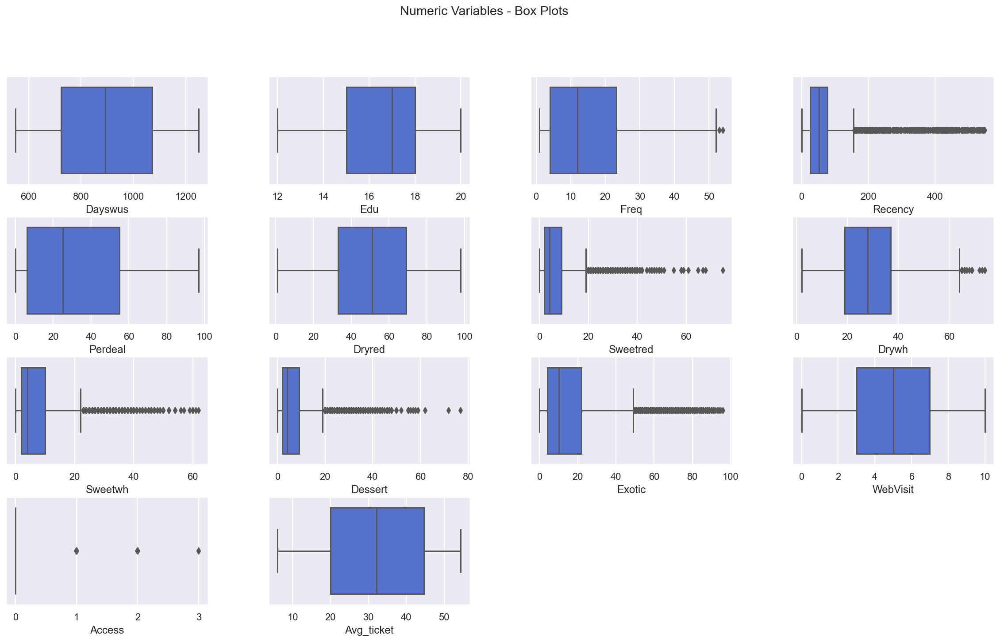

In [48]:
#Check boxplots after outliers removal
# Box plots for the metric features
sns.set()

# Prepare figure and create individual axes where each box plot will be placed
fig, axes = plt.subplots(4, ceil(len(metric_features) /4), figsize=(20, 11))

# Plot the data
# Iterate across axes objects and associate each box plot
for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(df2[feat], ax=ax,color="royalblue")
    
# Layout
# Add a centered title to the figure
title = "Numeric Variables - Box Plots"

plt.suptitle(title)

# Adjust the space between plots
plt.subplots_adjust(wspace=0.3, hspace=0.3)

# Remove the last  2 plots
axes.flatten()[-2].remove()
axes.flatten()[-1].remove()
# Show plots
plt.show()

#### After testing removing based on 4 combined methods and realising that did not seem to make a big difference on the box plots in terms of outliers, we have dropped this approach and decided to apply Inter quartile range (IQR) only on five features 

#### For the features Drywh, Freq the best multiplier is 1 and for the features Dessert,Sweetred,Sweetwh, the best multiplier is 4.5

In [49]:
#Create a copy of the dataset
df1_iqr = df1.copy()
#Define the features to apply the IQR method
iqr_features= ['Drywh','Freq']
#Run the function setting the multiplier =1 and create a new columns to store the results
df1_iqr['out'] = out_iqr(df1_iqr[iqr_features], multiplier = 1)
#Show the results
df1_iqr['out'].value_counts()

0    9721
1     279
Name: out, dtype: int64

In [50]:
#Filter the data excluding the outliers detected
df1_iqr1 = df1_iqr[df1_iqr['out']==0]
#Create a dataset to store the outliers detected
df1_iqr_out = df1_iqr[df1_iqr['out']==1]
#Drop the column create in both datasets
df1_iqr1.drop(['out'], axis=1, inplace=True)
df1_iqr_out.drop(['out'], axis=1, inplace=True)

In [51]:
#Second step
#Define the features to apply the IQR method
iqr_features2= ['Dessert','Sweetred','Sweetwh']
#Run the function setting the multiplier =4.5 and create a new columns to store the results
df1_iqr1['out'] = out_iqr(df1_iqr1[iqr_features2], multiplier = 4.5)
#Show the results
df1_iqr1['out'].value_counts()

0    9646
1      75
Name: out, dtype: int64

In [52]:
#Filter the data excluding the outliers detected
df1_iqr2 = df1_iqr1[df1_iqr1['out']==0]
#Create a dataset to the outliers detected
df1_iqr_out2 = df1_iqr1[df1_iqr1['out']==1]
#Drop the column create in both datasets
df1_iqr2.drop(['out'], axis=1, inplace=True)
df1_iqr_out2.drop(['out'], axis=1, inplace=True)

In [53]:
print('Percentage of data kept after removing outliers:', np.round(df1_iqr2.shape[0] / df1.shape[0], 4))

Percentage of data kept after removing outliers: 0.9646


In [54]:
#Check the results
df1_iqr2.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 9646 entries, 5325.0 to 4914.0
Data columns (total 24 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Dayswus      9646 non-null   float64
 1   Edu          9646 non-null   float64
 2   Kidhome      9646 non-null   float64
 3   Teenhome     9646 non-null   float64
 4   Freq         9646 non-null   float64
 5   Recency      9646 non-null   float64
 6   Perdeal      9646 non-null   float64
 7   Dryred       9646 non-null   float64
 8   Sweetred     9646 non-null   float64
 9   Drywh        9646 non-null   float64
 10  Sweetwh      9646 non-null   float64
 11  Dessert      9646 non-null   float64
 12  Exotic       9646 non-null   float64
 13  WebVisit     9646 non-null   float64
 14  SMRack       9646 non-null   int64  
 15  LGRack       9646 non-null   int64  
 16  Humid        9646 non-null   int64  
 17  Spcork       9646 non-null   int64  
 18  Bucket       9646 non-null   int64  
 1

In [55]:
#Merging the both datasets used to store the outliers detected
df1_out_final = df1_iqr_out.append(df1_iqr_out2)

In [56]:
#Check the outliers dataset
df1_out_final.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 354 entries, 10749.0 to 5957.0
Data columns (total 24 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Dayswus      354 non-null    float64
 1   Edu          354 non-null    float64
 2   Kidhome      354 non-null    float64
 3   Teenhome     354 non-null    float64
 4   Freq         354 non-null    float64
 5   Recency      354 non-null    float64
 6   Perdeal      354 non-null    float64
 7   Dryred       354 non-null    float64
 8   Sweetred     354 non-null    float64
 9   Drywh        354 non-null    float64
 10  Sweetwh      354 non-null    float64
 11  Dessert      354 non-null    float64
 12  Exotic       354 non-null    float64
 13  WebVisit     354 non-null    float64
 14  SMRack       354 non-null    int64  
 15  LGRack       354 non-null    int64  
 16  Humid        354 non-null    int64  
 17  Spcork       354 non-null    int64  
 18  Bucket       354 non-null    int64  
 1

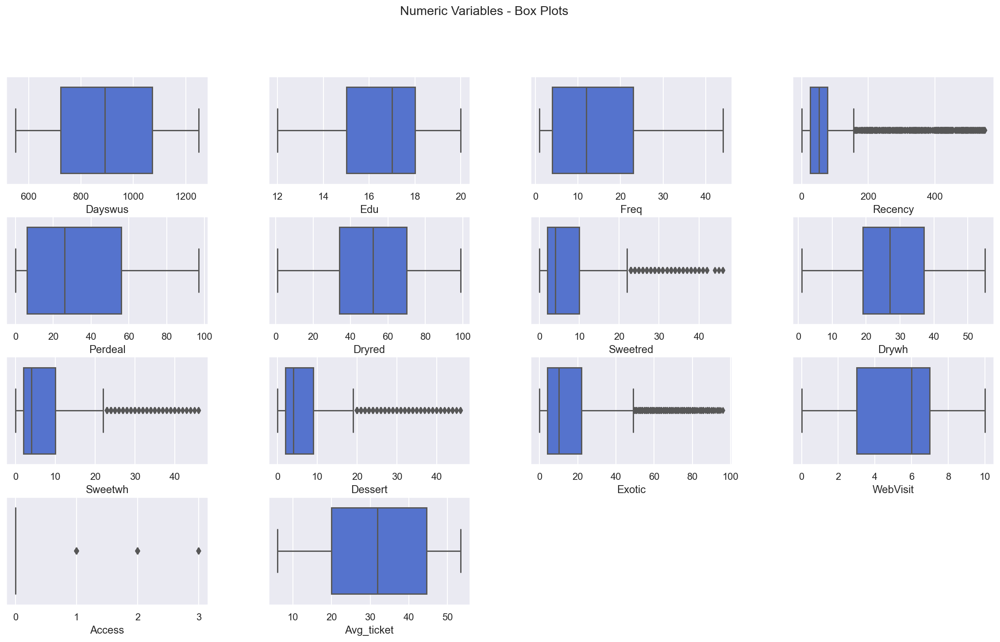

In [57]:
#Check boxplots after outliers removal
# Box plots for the metric features
sns.set()

# Prepare figure and create individual axes where each box plot will be placed
fig, axes = plt.subplots(4, ceil(len(metric_features) /4), figsize=(20, 11))

# Plot the data
# Iterate across axes objects and associate each box plot
for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(df1_iqr2[feat], ax=ax,color="royalblue")
    
# Layout
# Add a centered title to the figure
title = "Numeric Variables - Box Plots"

plt.suptitle(title)

# Adjust the space between plots
plt.subplots_adjust(wspace=0.3, hspace=0.3)

# Remove the last  2 plots
axes.flatten()[-2].remove()
axes.flatten()[-1].remove()
# Show plots
plt.show()

In [58]:
#Replace df1 by the method we decided
#IQR for the  5 variables. 
df1 = df1_iqr2.copy()

In [59]:
#Check the data
df1.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 9646 entries, 5325.0 to 4914.0
Data columns (total 24 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Dayswus      9646 non-null   float64
 1   Edu          9646 non-null   float64
 2   Kidhome      9646 non-null   float64
 3   Teenhome     9646 non-null   float64
 4   Freq         9646 non-null   float64
 5   Recency      9646 non-null   float64
 6   Perdeal      9646 non-null   float64
 7   Dryred       9646 non-null   float64
 8   Sweetred     9646 non-null   float64
 9   Drywh        9646 non-null   float64
 10  Sweetwh      9646 non-null   float64
 11  Dessert      9646 non-null   float64
 12  Exotic       9646 non-null   float64
 13  WebVisit     9646 non-null   float64
 14  SMRack       9646 non-null   int64  
 15  LGRack       9646 non-null   int64  
 16  Humid        9646 non-null   int64  
 17  Spcork       9646 non-null   int64  
 18  Bucket       9646 non-null   int64  
 1

### Encoding categorical features

In [60]:
# One hot encode categorical features
ohc_features = non_metric_features.copy()

ohc = OneHotEncoder(sparse=False)
df_ohc = pd.DataFrame(ohc.fit_transform(df1[ohc_features]),
                      index=df1.index,
                      columns=ohc.get_feature_names(ohc_features))
df1 = pd.concat([df1.loc[:, df1.columns.drop(ohc_features)], df_ohc], axis=1)

In [61]:
#Show the results
df1

,Dayswus,Edu,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,Access,Avg_ticket,SMRack_0,SMRack_1,LGRack_0,LGRack_1,Spcork_0,Spcork_1,Bucket_0,Bucket_1,Humid_0,Humid_1,Complain_0,Complain_1,Mailfriend_0,Mailfriend_1,Emailfriend_0,Emailfriend_1,Kidhome_0.0,Kidhome_1.0,Teenhome_0.0,Teenhome_1.0
Custid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5325.0,653.0,20.0,20.0,18.0,7.0,67.0,4.0,26.0,2.0,1.0,1.0,5.0,0,41.30,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
3956.0,1041.0,18.0,36.0,33.0,2.0,49.0,0.0,46.0,1.0,3.0,0.0,4.0,0,51.44,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
3681.0,666.0,12.0,4.0,56.0,88.0,4.0,29.0,14.0,32.0,21.0,48.0,8.0,0,9.75,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0
2829.0,1049.0,16.0,2.0,46.0,70.0,86.0,1.0,11.0,1.0,1.0,55.0,7.0,0,18.50,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0
8788.0,837.0,16.0,2.0,3.0,35.0,85.0,0.0,12.0,2.0,1.0,28.0,6.0,0,18.00,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383.0,1132.0,20.0,19.0,59.0,22.0,78.0,0.0,20.0,1.0,1.0,11.0,4.0,1,40.84,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0
4070.0,596.0,15.0,18.0,45.0,5.0,30.0,12.0,36.0,10.0,12.0,13.0,2.0,0,40.00,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
7909.0,619.0,12.0,3.0,65.0,23.0,6.0,24.0,10.0,38.0,22.0,41.0,5.0,0,15.67,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


### Normalize data

In [62]:
#Create a copy
df_standard=df1.copy()

In [63]:
#Select data
features = df_standard.columns
# Create a StandardScaler
scale = StandardScaler()
# Fit and Transform data by applying the scale obtained in the previous command
scale_feat= scale.fit_transform(df_standard[features])
#Applying the transformation in the dataset
df_standard[features]=scale_feat
#Check the results
df_standard.head()

,Dayswus,Edu,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,Access,Avg_ticket,SMRack_0,SMRack_1,LGRack_0,LGRack_1,Spcork_0,Spcork_1,Bucket_0,Bucket_1,Humid_0,Humid_1,Complain_0,Complain_1,Mailfriend_0,Mailfriend_1,Emailfriend_0,Emailfriend_1,Kidhome_0.0,Kidhome_1.0,Teenhome_0.0,Teenhome_1.0
Custid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5325.0,-1.202800,1.736339,0.488342,-0.633474,-0.919126,0.679379,-0.389563,-0.162325,-0.643452,-0.771188,-0.906415,-0.098422,-0.449511,0.697892,0.295573,-0.295573,0.269466,-0.269466,0.258227,-0.258227,0.10936,-0.10936,0.281661,-0.281661,0.105409,-0.105409,0.336091,-0.336091,0.229341,-0.229341,0.848734,-0.848734,0.970777,-0.970777
3956.0,0.715481,0.664455,1.876014,-0.418859,-1.098959,-0.097768,-0.916407,1.519777,-0.773164,-0.508079,-0.965315,-0.529764,-0.449511,1.447690,0.295573,-0.295573,0.269466,-0.269466,-3.872555,3.872555,0.10936,-0.10936,0.281661,-0.281661,0.105409,-0.105409,0.336091,-0.336091,0.229341,-0.229341,0.848734,-0.848734,0.970777,-0.970777
3681.0,-1.138527,-2.551198,-0.899331,-0.089783,1.994173,-2.040635,2.903217,-1.171586,3.247920,1.859901,1.861844,1.195602,-0.449511,-1.635059,0.295573,-0.295573,0.269466,-0.269466,0.258227,-0.258227,0.10936,-0.10936,0.281661,-0.281661,0.105409,-0.105409,0.336091,-0.336091,0.229341,-0.229341,-1.178225,1.178225,0.970777,-0.970777
2829.0,0.755033,-0.407429,-1.072791,-0.232859,1.346773,1.499701,-0.784696,-1.423901,-0.773164,-0.771188,2.274138,0.764260,-0.449511,-0.988044,0.295573,-0.295573,0.269466,-0.269466,0.258227,-0.258227,0.10936,-0.10936,0.281661,-0.281661,0.105409,-0.105409,-2.975384,2.975384,-4.360327,4.360327,-1.178225,1.178225,-1.030102,1.030102
8788.0,-0.293100,-0.407429,-1.072791,-0.848089,0.087940,1.456526,-0.916407,-1.339796,-0.643452,-0.771188,0.683861,0.332919,-0.449511,-1.025016,0.295573,-0.295573,0.269466,-0.269466,0.258227,-0.258227,0.10936,-0.10936,0.281661,-0.281661,0.105409,-0.105409,0.336091,-0.336091,0.229341,-0.229341,0.848734,-0.848734,-1.030102,1.030102


In [64]:
#Check the statistics summary
df_standard.describe().apply(lambda s: s.apply(lambda x:format(x,'g')))

,Dayswus,Edu,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,Access,Avg_ticket,SMRack_0,SMRack_1,LGRack_0,LGRack_1,Spcork_0,Spcork_1,Bucket_0,Bucket_1,Humid_0,Humid_1,Complain_0,Complain_1,Mailfriend_0,Mailfriend_1,Emailfriend_0,Emailfriend_1,Kidhome_0.0,Kidhome_1.0,Teenhome_0.0,Teenhome_1.0
count,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646,9646
mean,1.86215e-16,-1.74809e-16,5.85842e-18,5.8354e-18,-6.67561e-17,-6.57548e-17,-3.0351e-17,-8.04756e-17,1.46173e-16,-1.85191e-17,8.07404e-17,2.22534e-16,-1.95964e-16,-4.46299e-16,-3.08895e-15,3.0868e-15,5.56608e-17,-2.1126e-16,1.39037e-16,-5.18039e-16,1.21664e-15,1.40306e-16,8.28696e-16,-8.2377e-16,-4.17505e-16,2.61888e-16,4.46334e-16,-4.35169e-16,1.28741e-16,2.99769e-17,-7.59293e-17,1.75569e-16,4.03759e-16,-4.03759e-16
std,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005,1.00005
min,-1.71203,-2.5512,-1.15952,-0.891012,-1.17089,-2.17016,-0.916407,-2.26495,-0.902877,-0.902742,-0.965315,-2.25513,-0.449511,-1.91235,-3.38326,-0.295573,-3.71104,-0.269466,-3.87256,-0.258227,-9.14407,-0.10936,-3.55036,-0.281661,-9.48683,-0.105409,-2.97538,-0.336091,-4.36033,-0.229341,-1.17823,-0.848734,-1.0301,-0.970777
25%,-0.861662,-0.943372,-0.899331,-0.519013,-0.955093,-0.74539,-0.652985,-0.75106,-0.643452,-0.639633,-0.729718,-0.961105,-0.449511,-0.877127,0.295573,-0.295573,0.269466,-0.269466,0.258227,-0.258227,0.10936,-0.10936,0.281661,-0.281661,0.105409,-0.105409,0.336091,-0.336091,0.229341,-0.229341,-1.17823,-0.848734,-1.0301,-0.970777
50%,-0.0211784,0.128513,-0.205495,-0.147013,-0.235759,0.0317567,-0.389563,-0.0782196,-0.384027,-0.376524,-0.376323,0.332919,-0.449511,0.0042921,0.295573,-0.295573,0.269466,-0.269466,0.258227,-0.258227,0.10936,-0.10936,0.281661,-0.281661,0.105409,-0.105409,0.336091,-0.336091,0.229341,-0.229341,0.848734,-0.848734,0.970777,-0.970777
75%,0.868745,0.664455,0.74853,0.224986,0.84324,0.808903,0.400705,0.762831,0.394247,0.281248,0.330467,0.76426,-0.449511,0.939691,0.295573,-0.295573,0.269466,-0.269466,0.258227,-0.258227,0.10936,-0.10936,0.281661,-0.281661,0.105409,-0.105409,0.336091,-0.336091,0.229341,-0.229341,0.848734,1.17823,0.970777,1.0301
max,1.74878,1.73634,2.56985,6.9639,2.31787,2.06097,5.14231,2.27672,5.06389,5.14876,4.689,2.05828,5.32923,1.59632,0.295573,3.38326,0.269466,3.71104,0.258227,3.87256,0.10936,9.14407,0.281661,3.55036,0.105409,9.48683,0.336091,2.97538,0.229341,4.36033,0.848734,1.17823,0.970777,1.0301


In [65]:
#Create a copy only with metric features to run the cluster.
#To run the clustering solutions, we selected only numerical features. 
df_cluster_standard = df_standard[metric_features].copy()

In [66]:
#Look the data
df_cluster_standard.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 9646 entries, 5325.0 to 4914.0
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Dayswus     9646 non-null   float64
 1   Edu         9646 non-null   float64
 2   Freq        9646 non-null   float64
 3   Recency     9646 non-null   float64
 4   Perdeal     9646 non-null   float64
 5   Dryred      9646 non-null   float64
 6   Sweetred    9646 non-null   float64
 7   Drywh       9646 non-null   float64
 8   Sweetwh     9646 non-null   float64
 9   Dessert     9646 non-null   float64
 10  Exotic      9646 non-null   float64
 11  WebVisit    9646 non-null   float64
 12  Access      9646 non-null   float64
 13  Avg_ticket  9646 non-null   float64
dtypes: float64(14)
memory usage: 1.1 MB


## Clustering

### Kmeans - Clustering

#### K means is the most popular clustering algorithm. It’s efficient in terms of time, easy to understand and easy to implement. But its major problem is to define the number of clusters and its very sensitive to the initial position of seeds. 

#### To define the number of clusters, we plot 3 metrics to help us:
#### 1) The Inertia plot shows the dispersion of the points within the cluster, meaning a small inertia is the best outcome. 
#### 2) The Average silhouette plot determines how well each object lies within its cluster, being the best outcome a higher number. 
#### At last, the Davies-Bouldin score plot which index is based on a ratio between distances within the cluster and distances between clusters, the best outcome is the smallest index.

In [67]:
def kmeans_elbows_plot(data, k):

    K = range(2, k) 

    inertia = []
    avg_silhouette = []
    db_scores =[]
    for k in K:
        kmeanModel = KMeans(n_clusters=k, init='k-means++', n_init=15, random_state=1)
        kmeanModel.fit(data)
        clusters = kmeanModel.labels_
        inertia.append(kmeanModel.inertia_)
        avg_silhouette.append(silhouette_score(data, clusters))
        db_scores.append(davies_bouldin_score(data, clusters))

    # The inertia plot
    plt.figure(figsize=(9,5))
    plt.plot(inertia)
    plt.ylabel("Inertia: SSw")
    plt.xlabel("Number of clusters+2")
    plt.title("Inertia plot over clusters", size=15)
    plt.show()

    # The average silhouette plot
    plt.figure(figsize=(9,5))
    plt.plot(avg_silhouette)
    plt.ylabel("Average silhouette")
    plt.xlabel("Number of clusters+2")
    plt.title("Average silhouette plot over clusters", size=15)
    plt.show()

    # The Davies Bouldin score
    plt.figure(figsize=(9,5))
    plt.plot(db_scores)
    plt.ylabel("Davies-Bouldin")
    plt.xlabel("Number of clusters+2")
    plt.title("Davies-Bouldin plot over clusters", size=15)
    plt.show()

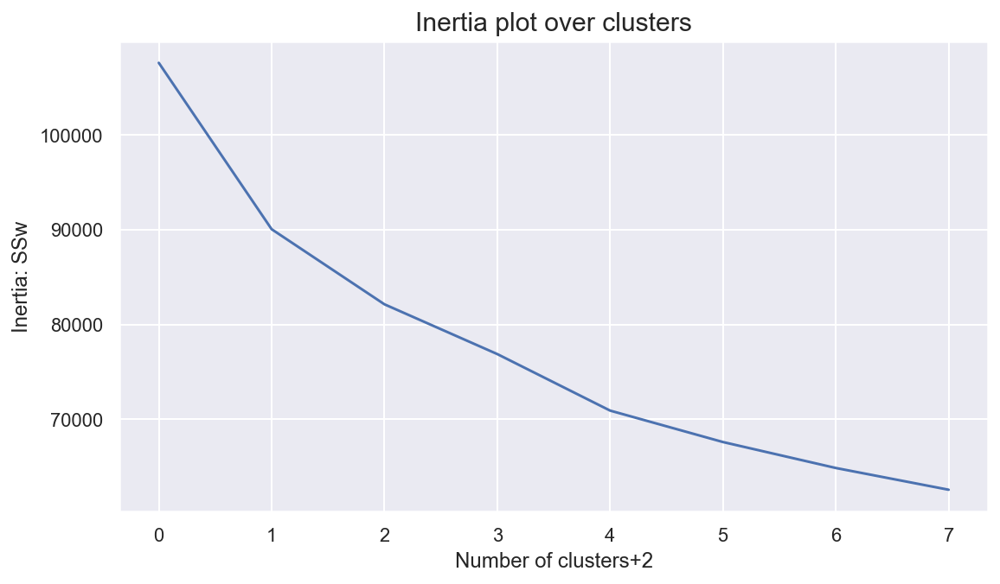

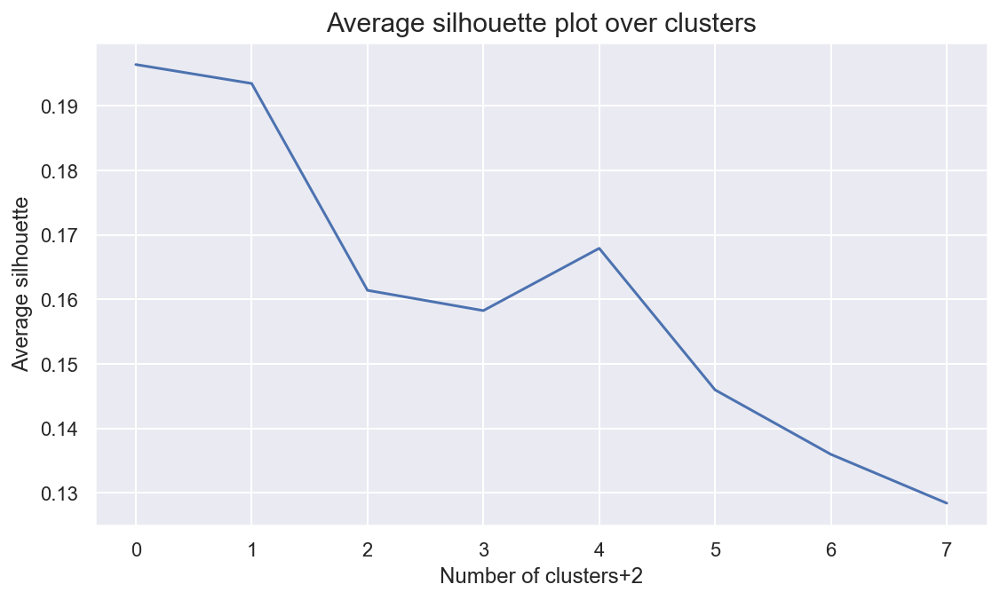

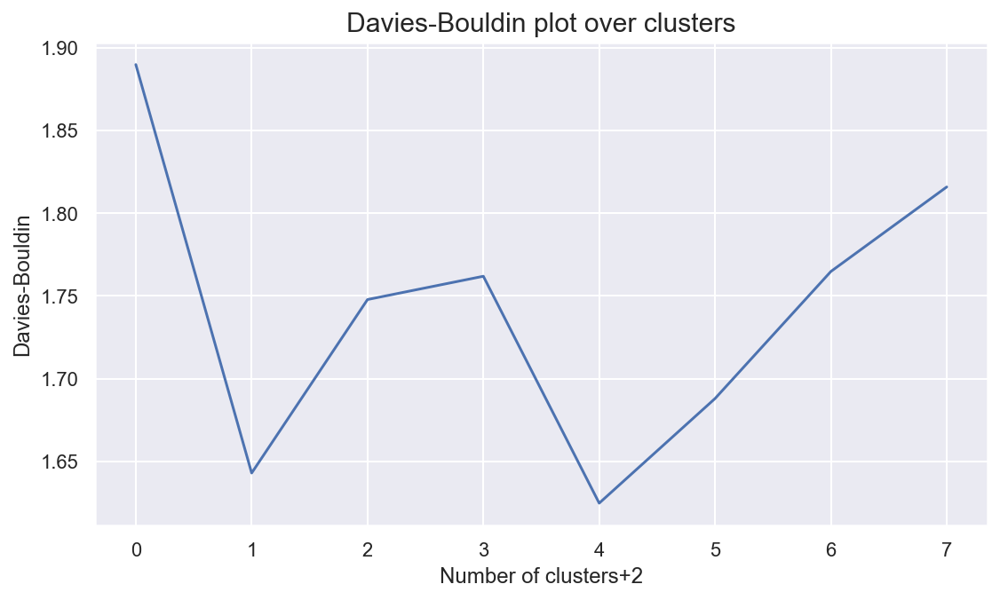

In [68]:
kmeans_elbows_plot(df_cluster_standard, 10)

#### We also ran the silhouette plot that shows a coefficient for the clusters’ quality depending on the number of clusters chosen. We applied in with some possible cluster numbers.

In [69]:
def complete_sh_score(data, k):
    # Storing average silhouette metric
    range_clusters = range(1, k)
    avg_silhouette = []
    for nclus in range_clusters:
        # Skip nclus == 1
        if nclus == 1:
            continue

        # Create a figure
        fig = plt.figure(figsize=(13, 7))

        # Initialize the KMeans object with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
        cluster_labels = kmclust.fit_predict(data)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed clusters
        silhouette_avg = silhouette_score(data, cluster_labels)
        avg_silhouette.append(silhouette_avg)
        print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(data, cluster_labels)

        y_lower = 10
        for i in range(nclus):
            # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
            ith_cluster_silhouette_values.sort()

            # Get y_upper to demarcate silhouette y range size
            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            # Filling the silhouette
            color = cm.nipy_spectral(float(i) / nclus)
            plt.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        plt.title("The silhouette plot for the various clusters.")
        plt.xlabel("The silhouette coefficient values")
        plt.ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        plt.axvline(x=silhouette_avg, color="red", linestyle="--")

        # The silhouette coefficient can range from -1, 1
        xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
        plt.xlim([xmin, xmax])

        # The (nclus+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        plt.ylim([0, len(data) + (nclus + 1) * 10])

        plt.yticks([])  # Clear the yaxis labels / ticks
        plt.xticks(np.arange(xmin, xmax, 0.1))

For n_clusters = 2, the average silhouette_score is : 0.19643048775972693
For n_clusters = 3, the average silhouette_score is : 0.1934958883442155
For n_clusters = 4, the average silhouette_score is : 0.161426817164135


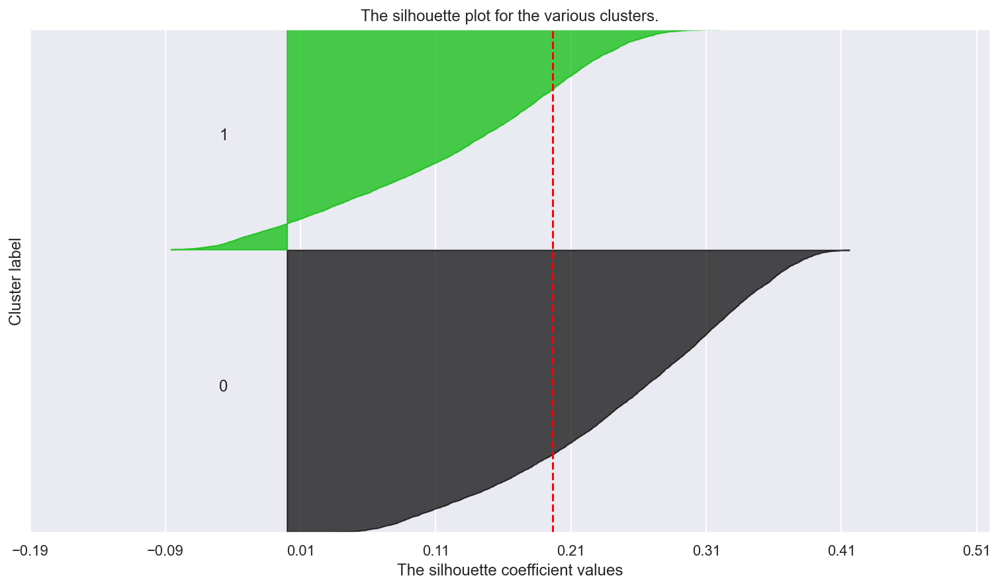

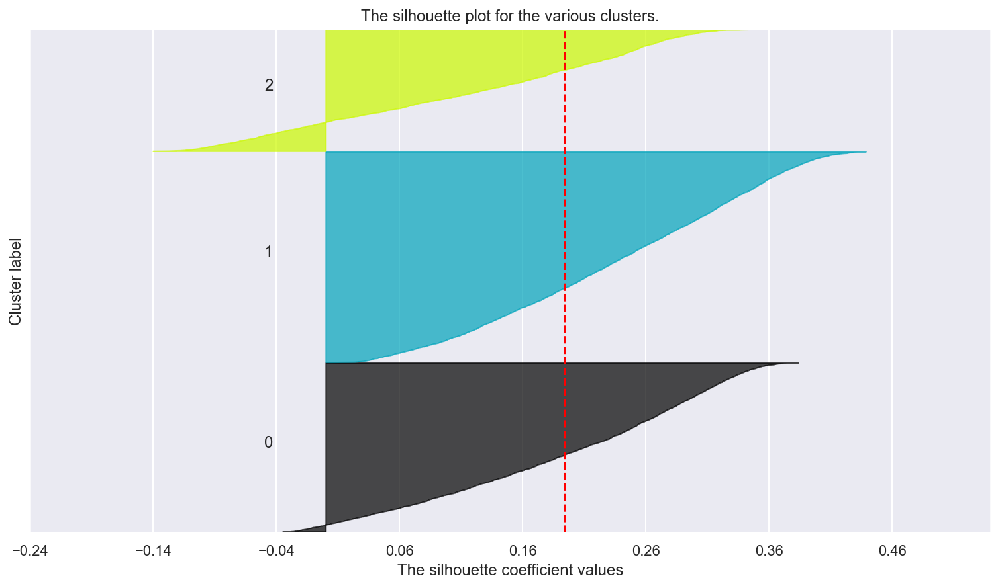

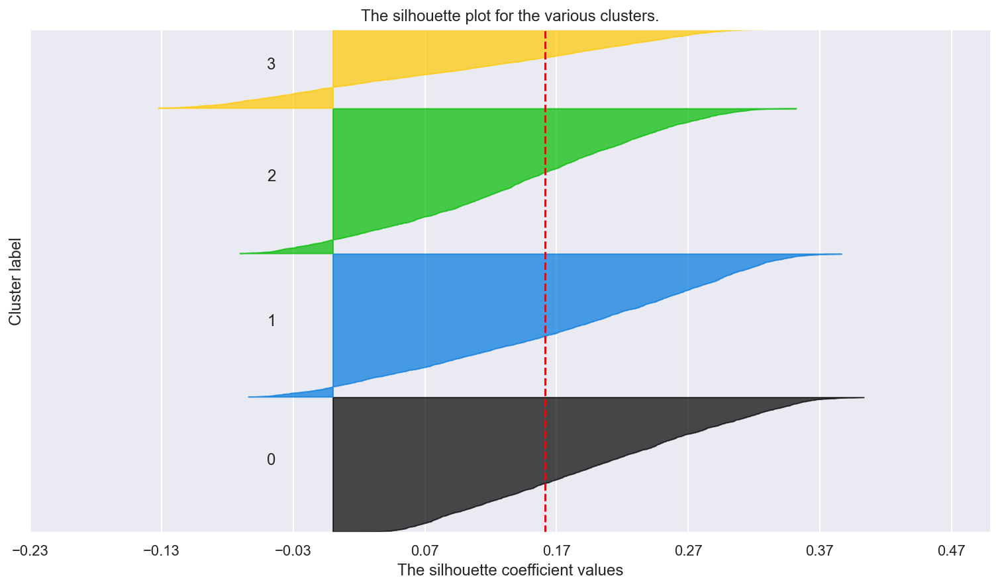

In [70]:
complete_sh_score(df_cluster_standard, 5)

#### After looking to the plots, we decided to proceed with 3 clusters

In [71]:
#We set the ‘k-means++’ as the initialization method (init parameter) 
#with 15 number of iterations to choose the best centroid in terms of inertia (n_init parameter).
kmeans_standard = KMeans(
    n_clusters=3,
    init='k-means++',
    n_init=15,
    random_state=1
)
kmeans_standard_labels = kmeans_standard.fit_predict(df_cluster_standard)

In [72]:
#Check the partion cluster
df_cluster_standard['kmeans_standard_labels'] = kmeans_standard_labels
df_cluster_standard.groupby('kmeans_standard_labels').count()

,Dayswus,Edu,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,Access,Avg_ticket
kmeans_standard_labels,,,,,,,,,,,,,,
0,3251,3251,3251,3251,3251,3251,3251,3251,3251,3251,3251,3251,3251,3251
1,4053,4053,4053,4053,4053,4053,4053,4053,4053,4053,4053,4053,4053,4053
2,2342,2342,2342,2342,2342,2342,2342,2342,2342,2342,2342,2342,2342,2342


## Evaluation

#### The R2 is a measure of the homogenity of a cluster solution. 

In [73]:
#Functions to get the R2.

def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable
def adjusted_r2(df, labels):
    """Return the overall adjusted R-squared"""
    
    # 1. calculate sst
    sst = get_ss(df)
    
    # 2. calculate ssw
    grouped_var = df.groupby(labels).var()
    grouped_count = df.groupby(labels).count() - 1
    ssw = np.sum(np.sum(grouped_var * grouped_count))
    
    # 3. return adjusted R-squared
    return 1 - ssw/sst

In [74]:
#R2 for k-means algorithm
adjusted_r2(df_cluster_standard,kmeans_standard_labels)

0.35921639645030934

#### Describe clusters - Visualizations

In [75]:
def cluster_profiles(df,label_columns, figsize, compar_titles=None, frequency = True):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    if frequency:
        fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    else:
        fig, axes = plt.subplots(nrows=len(label_columns), ncols=1, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        if frequency:    
            sns.barplot(x=label, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-90)
        if frequency:
            ax[1].set_xticklabels(cluster_labels)
            ax[1].set_xlabel("")
            ax[1].set_ylabel("Absolute Frequency")
            ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
    
    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profilling", fontsize=10)
    plt.show()

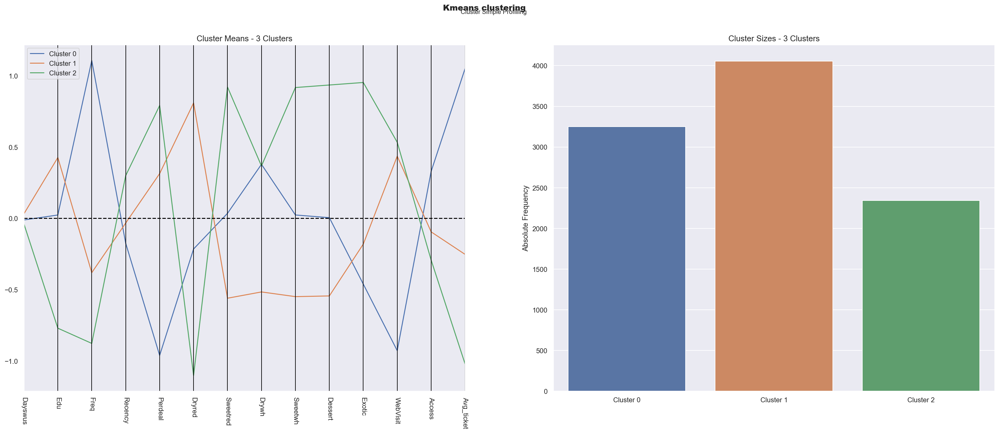

In [76]:
# Profilling cluster
cluster_profiles(
    df = df_cluster_standard[metric_features + ['kmeans_standard_labels']], 
    label_columns = ['kmeans_standard_labels'], 
    figsize = (28, 10), 
    compar_titles = ["Kmeans clustering"]
)

#### T-SNE (t-Distributed Stochastic Neighbor Embedding) is most used for multidimensional visualizations. It has many application but in this work , our objective is visualize clusters within the data and how a cluster solution fits them

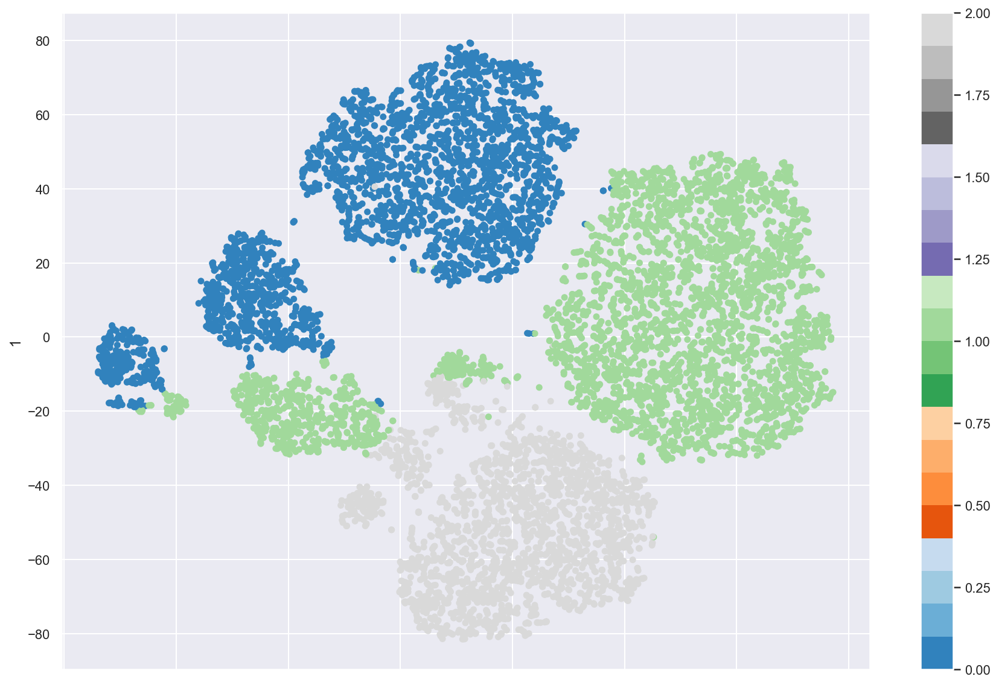

In [77]:
# Run the algorithm, fit and tranform the data
two_dim = TSNE(random_state=42).fit_transform( df_cluster_standard)
#Plot the data
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c= df_cluster_standard['kmeans_standard_labels'], colormap='tab20c', figsize=(15,10))
plt.show()

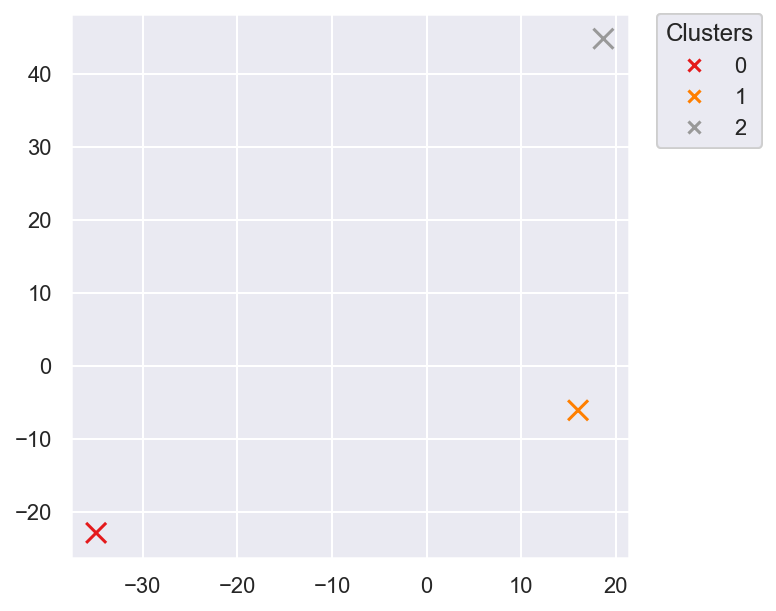

In [78]:
#Visualizing centroids with t-SNE
tsne = TSNE(n_components=2, perplexity=50, learning_rate=200)
#Run the algorithm, transform and fit the data
df_tsne = tsne.fit_transform( df_cluster_standard)
#Create a data frame to store the results of tnse
df_tsne = pd.DataFrame(df_tsne, index =  df_cluster_standard.index)\
            .merge(df_cluster_standard['kmeans_standard_labels'], right_index = True, left_index = True)
#Store the centroids
centroids = df_tsne.groupby('kmeans_standard_labels').mean()
#Plot the data
fig, ax = plt.subplots(figsize = (5,5))
data = pd.DataFrame(centroids)
scatter = ax.scatter(x = data.iloc[:,0], y = data.iloc[:,1], c = range(3),marker = 'x', s = 100, cmap = 'Set1')
legend1 = ax.legend(*scatter.legend_elements(), title = 'Clusters', bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
ax.add_artist(legend1)
plt.show()

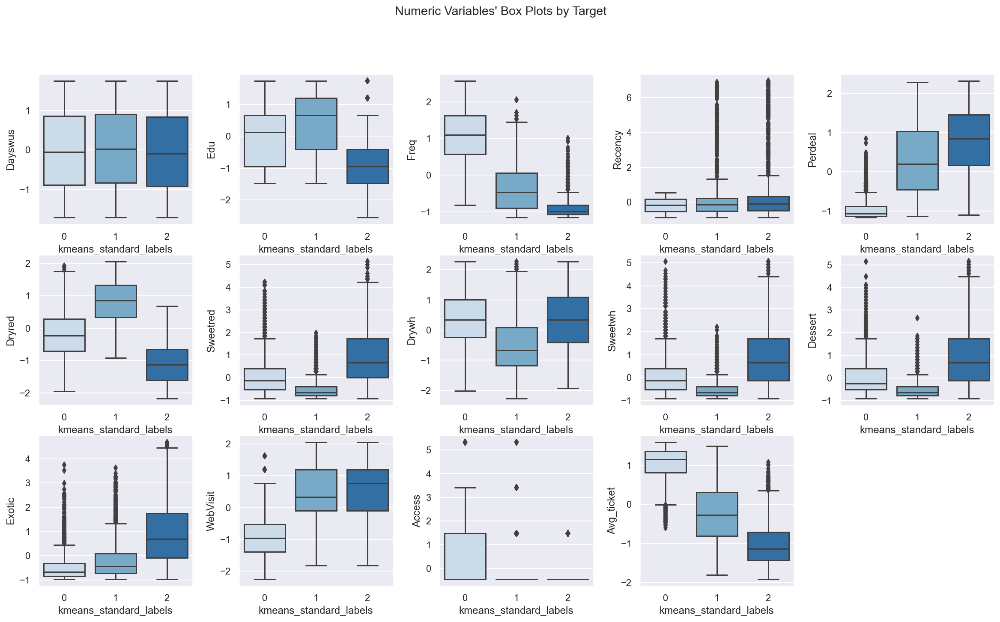

In [79]:
# All Numeric Variables' Box Plots in one figure
sns.set()

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(3, ceil(len(metric_features) / 3), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot:
for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(x=df_cluster_standard['kmeans_standard_labels'], y=df_cluster_standard[feat], ax=ax,palette="Blues")
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots by Target"
plt.suptitle(title)
plt.subplots_adjust(wspace=0.3)

# Remove the last graphic
axes.flatten()[-1].remove()

plt.show()

In [80]:
#Export the transform data to trainning our application developed to find the cluster for other customers. 
df_cluster_standard.to_csv(os.path.join("www_cluster.csv"), index=False)

#### We also tried Hierarchical clustering whose outcome was reasonable, but as K means clustering has a higher R2, we decided for proceeding the analysis with the latter method. 

### Hierarquical Cluster

In [81]:
#Create a new data to run hierarquical cluster solution. Filtering the metric features. 
df_cluster_standard2 = df_standard[metric_features].copy()

In [82]:
#Funtion to get the R2s for the 4 different linkages of Hierarquical cluster
def get_r2_hc(df, link_method, max_nclus, min_nclus=1, dist="euclidean"):
    """This function computes the R2 for a set of cluster solutions given by the application of a hierarchical method.
    The R2 is a measure of the homogenity of a cluster solution. It is based on SSt = SSw + SSb and R2 = SSb/SSt. 
    
    Parameters:
    df (DataFrame): Dataset to apply clustering
    link_method (str): either "ward", "complete", "average", "single"
    max_nclus (int): maximum number of clusters to compare the methods
    min_nclus (int): minimum number of clusters to compare the methods. Defaults to 1.
    dist (str): distance to use to compute the clustering solution. Must be a valid distance. Defaults to "euclidean".
    
    Returns:
    ndarray: R2 values for the range of cluster solutions
    """
    def get_ss(df):
        ss = np.sum(df.var() * (df.count() - 1))
        return ss  # return sum of sum of squares of each df variable
    
    sst = get_ss(df)  # get total sum of squares
    
    r2 = []  # where we will store the R2 metrics for each cluster solution
    
    for i in range(min_nclus, max_nclus+1):  # iterate over desired ncluster range
        cluster = AgglomerativeClustering(n_clusters=i, affinity=dist, linkage=link_method)
        hclabels = cluster.fit_predict(df) #get cluster labels
        df_concat = pd.concat((df, pd.Series(hclabels, name='labels')), axis=1)  # concat df with labels
        ssw_labels = df_concat.groupby(by='labels').apply(get_ss)  # compute ssw for each cluster labels
        ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
        r2.append(ssb / sst)  # save the R2 of the given cluster solution
        
    return np.array(r2)

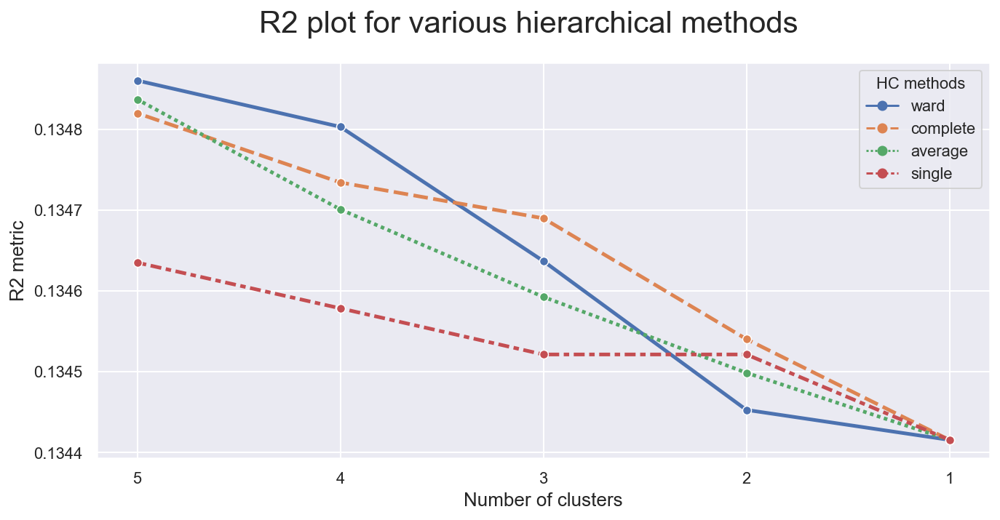

In [83]:
# Prepare input
hc_methods = ["ward", "complete", "average", "single"]
# Call function defined above to obtain the R2 statistic for each hc_method
max_nclus = 5
r2_hc_methods = np.vstack([get_r2_hc(df=df_cluster_standard2, link_method=link, max_nclus=max_nclus) for link in hc_methods]).T
r2_hc_methods = pd.DataFrame(r2_hc_methods, index=range(1, max_nclus + 1), columns=hc_methods)

sns.set()
# Plot data
fig = plt.figure(figsize=(11,5))
sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=21)
plt.gca().invert_xaxis()  # invert x axis
plt.legend(title="HC methods", title_fontsize=11)
plt.xticks(range(1, max_nclus + 1))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)

plt.show()

#### After looking to R2 plot, we decide to proceed with ward linkage.

In [84]:
#Functions to create the dendogram to decide the number of clusters
def full_tree(data, distance = 'euclidean', linkage = 'complete'):
    
    hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
    hclust.fit_predict(data)
    return hclust

def full_tree_visual(full_tree, thresh = 5, distance = 'euclidean', linkage = 'ward'):
    
    hclust = full_tree

    counts = np.zeros(hclust.children_.shape[0])
    n_samples = len(hclust.labels_)

    for i, merge in enumerate(hclust.children_):

        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:

                current_count += 1  
            else:

                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [hclust.children_, hclust.distances_, counts]
    ).astype(float)
#Plot the data
    sns.set()
    fig = plt.figure(figsize=(11,5))
    y_threshold = thresh
    dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
#Set the threshold
    plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
#Layout
    plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
    plt.xlabel('Number of points in node (or index of point if no parenthesis)')
    plt.ylabel(f'{distance.title()} Distance', fontsize=13)
    plt.show()

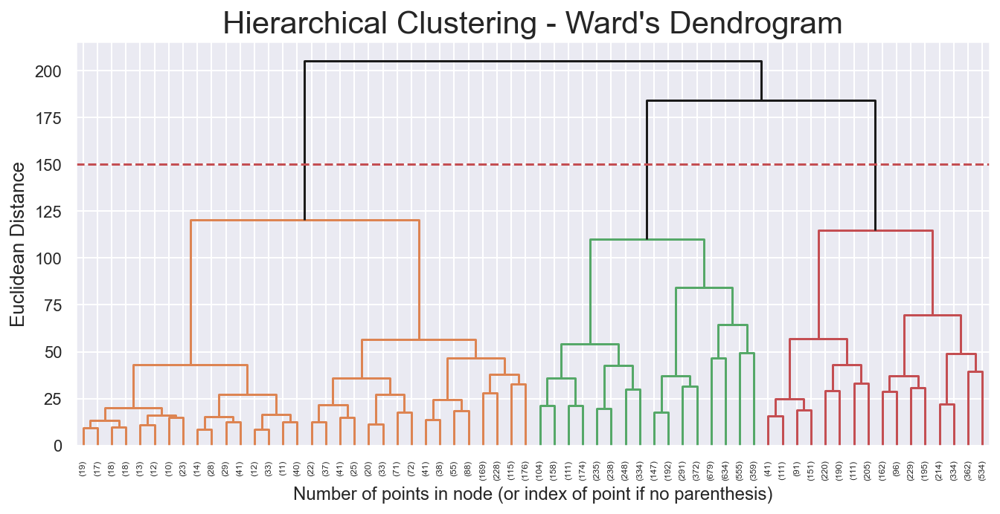

In [85]:
#We define the threshold as 150, after looking at the dendogram once. 
full_tree_mil = full_tree(df_cluster_standard2, linkage='ward', distance = 'euclidean')
full_tree_visual(full_tree_mil, thresh=150)

In [86]:
# Looking to the dendogram we concluded the best number of clusters is 3
#hc cluster solution
linkage = 'ward'
distance = 'euclidean'
hclust_ward = AgglomerativeClustering(linkage=linkage, affinity=distance, n_clusters=3)
hclust_ward_labels = hclust_ward.fit_predict(df_cluster_standard2)

In [87]:
#Check the partion cluster
df_cluster_standard2['hclust_ward_labels']=hclust_ward_labels
df_cluster_standard2.groupby('hclust_ward_labels').count()

,Dayswus,Edu,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,Access,Avg_ticket
hclust_ward_labels,,,,,,,,,,,,,,
0,1569,1569,1569,1569,1569,1569,1569,1569,1569,1569,1569,1569,1569,1569
1,3246,3246,3246,3246,3246,3246,3246,3246,3246,3246,3246,3246,3246,3246
2,4831,4831,4831,4831,4831,4831,4831,4831,4831,4831,4831,4831,4831,4831


In [88]:
#Get the R2 for Hierarquical cluster
adjusted_r2(df_cluster_standard2,hclust_ward_labels)

0.3083426755498665

### Decision tree classifier to evaluate the results

In [89]:
# Preparing the data
X = df_cluster_standard.drop(columns=['kmeans_standard_labels'])
y = df_cluster_standard.kmeans_standard_labels


In [90]:
#Check the data
X.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 9646 entries, 5325.0 to 4914.0
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Dayswus     9646 non-null   float64
 1   Edu         9646 non-null   float64
 2   Freq        9646 non-null   float64
 3   Recency     9646 non-null   float64
 4   Perdeal     9646 non-null   float64
 5   Dryred      9646 non-null   float64
 6   Sweetred    9646 non-null   float64
 7   Drywh       9646 non-null   float64
 8   Sweetwh     9646 non-null   float64
 9   Dessert     9646 non-null   float64
 10  Exotic      9646 non-null   float64
 11  WebVisit    9646 non-null   float64
 12  Access      9646 non-null   float64
 13  Avg_ticket  9646 non-null   float64
dtypes: float64(14)
memory usage: 1.4 MB


In [91]:
# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=42, max_depth = 12,criterion='entropy')
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 93.94% of the customers correctly


In [92]:
# Assessing feature importance
fi_col = []
fi = []
for i,column in enumerate(X):
    print('The feature importance for {} is : {}'.format(column,dt.feature_importances_[i]))
    fi_col.append(column)
    fi.append(dt.feature_importances_[i])

The feature importance for Dayswus is : 0.011171178594611248
The feature importance for Edu is : 0.027606827434044075
The feature importance for Freq is : 0.0036262418537550915
The feature importance for Recency is : 0.005741770576203857
The feature importance for Perdeal is : 0.05213689527633029
The feature importance for Dryred is : 0.3850356154403421
The feature importance for Sweetred is : 0.006363588641805652
The feature importance for Drywh is : 0.01918493250703724
The feature importance for Sweetwh is : 0.006662498945316174
The feature importance for Dessert is : 0.005684949366395089
The feature importance for Exotic is : 0.02616707147367702
The feature importance for WebVisit is : 0.053589638846753836
The feature importance for Access is : 0.001526409642835783
The feature importance for Avg_ticket is : 0.39550238140089256


In [93]:
#Create a dataframe to the feature importance, putting the feature in order from the highest importance to the lowest. 
df_fi = zip(fi_col,fi)
df_fi = pd.DataFrame(df_fi,columns = ['Features','Features Importance'])
df_fi = df_fi.sort_values('Features Importance',ascending= False).reset_index().drop('index',axis=1)
df_fi

,Features,Features Importance
0,Avg_ticket,0.395502
1,Dryred,0.385036
2,WebVisit,0.053590
3,Perdeal,0.052137
4,Edu,0.027607
5,Exotic,0.026167
6,Drywh,0.019185
7,Dayswus,0.011171
8,Sweetwh,0.006662
9,Sweetred,0.006364


<AxesSubplot:xlabel='Features Importance', ylabel='Features'>

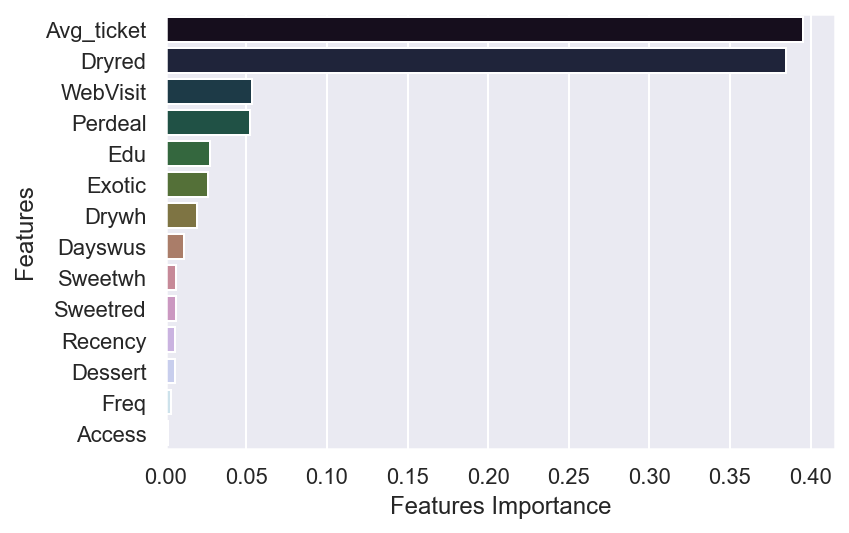

In [94]:
#Graphic to show the features with high importance
df_fi_10 = df_fi[0:15]
sns.barplot(df_fi_10['Features Importance'], df_fi_10['Features'], palette = 'cubehelix', orient = 'h')

#### We use de DT to set the cluster for the outliers.

In [95]:
#Check outliers data set
df1_out_final.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 354 entries, 10749.0 to 5957.0
Data columns (total 24 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Dayswus      354 non-null    float64
 1   Edu          354 non-null    float64
 2   Kidhome      354 non-null    float64
 3   Teenhome     354 non-null    float64
 4   Freq         354 non-null    float64
 5   Recency      354 non-null    float64
 6   Perdeal      354 non-null    float64
 7   Dryred       354 non-null    float64
 8   Sweetred     354 non-null    float64
 9   Drywh        354 non-null    float64
 10  Sweetwh      354 non-null    float64
 11  Dessert      354 non-null    float64
 12  Exotic       354 non-null    float64
 13  WebVisit     354 non-null    float64
 14  SMRack       354 non-null    int64  
 15  LGRack       354 non-null    int64  
 16  Humid        354 non-null    int64  
 17  Spcork       354 non-null    int64  
 18  Bucket       354 non-null    int64  
 1

In [96]:
#Filter meltric features of the outliers dataset
df2_out_final=df1_out_final[metric_features]

In [97]:
#Check the data
df2_out_final.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 354 entries, 10749.0 to 5957.0
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Dayswus     354 non-null    float64
 1   Edu         354 non-null    float64
 2   Freq        354 non-null    float64
 3   Recency     354 non-null    float64
 4   Perdeal     354 non-null    float64
 5   Dryred      354 non-null    float64
 6   Sweetred    354 non-null    float64
 7   Drywh       354 non-null    float64
 8   Sweetwh     354 non-null    float64
 9   Dessert     354 non-null    float64
 10  Exotic      354 non-null    float64
 11  WebVisit    354 non-null    float64
 12  Access      354 non-null    int64  
 13  Avg_ticket  354 non-null    float64
dtypes: float64(13), int64(1)
memory usage: 41.5 KB


In [98]:
#Predict the clusters for the outliers
df2_out_final['kmeans_standard_labels'] = dt.predict(df2_out_final)
df2_out_final.groupby('kmeans_standard_labels').count()

,Dayswus,Edu,Freq,Recency,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebVisit,Access,Avg_ticket
kmeans_standard_labels,,,,,,,,,,,,,,
0,13,13,13,13,13,13,13,13,13,13,13,13,13,13
1,341,341,341,341,341,341,341,341,341,341,341,341,341,341


In [99]:
#Merging the datasets (Non-outliers and Outliers) 
df_final = df_cluster_standard.append(df2_out_final)

In [100]:
#Look at the data
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 10000 entries, 5325.0 to 5957.0
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Dayswus                 10000 non-null  float64
 1   Edu                     10000 non-null  float64
 2   Freq                    10000 non-null  float64
 3   Recency                 10000 non-null  float64
 4   Perdeal                 10000 non-null  float64
 5   Dryred                  10000 non-null  float64
 6   Sweetred                10000 non-null  float64
 7   Drywh                   10000 non-null  float64
 8   Sweetwh                 10000 non-null  float64
 9   Dessert                 10000 non-null  float64
 10  Exotic                  10000 non-null  float64
 11  WebVisit                10000 non-null  float64
 12  Access                  10000 non-null  float64
 13  Avg_ticket              10000 non-null  float64
 14  kmeans_standard_labels  10000 

In [101]:
#Create a new dataset and apply the transformations done along the project
#The objective of this dataset is have back the collumns we dropped.
#With that, we are going to do a final analysis in the clusters
df2 = df.copy()
df2= df.set_index('Custid')
df2['Avg_ticket'] = np.round(df2['Monetary']/df2['Freq'],2)
df2

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,Avg_ticket
Custid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5325.0,653.0,55.0,20.0,78473.0,0.0,0.0,20.0,18.0,826.0,445.0,7.0,67.0,4.0,26.0,2.0,1.0,1.0,36.0,5.0,0,0,0,0,0,0,0,0,0,41.30
3956.0,1041.0,75.0,18.0,105087.0,0.0,0.0,36.0,33.0,1852.0,539.0,2.0,49.0,0.0,46.0,1.0,3.0,0.0,20.0,4.0,0,0,0,1,0,0,0,0,0,51.44
3681.0,666.0,18.0,12.0,27984.0,1.0,0.0,4.0,56.0,39.0,-7.0,88.0,4.0,29.0,14.0,32.0,21.0,48.0,60.0,8.0,0,0,0,0,0,0,0,0,0,9.75
2829.0,1049.0,42.0,16.0,61748.0,1.0,1.0,2.0,46.0,37.0,-6.0,70.0,86.0,1.0,11.0,1.0,1.0,55.0,59.0,7.0,0,0,0,0,0,0,0,1,1,18.50
8788.0,837.0,47.0,16.0,65789.0,0.0,1.0,2.0,3.0,36.0,4.0,35.0,85.0,0.0,12.0,2.0,1.0,28.0,63.0,6.0,0,0,0,0,0,0,0,0,0,18.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383.0,1132.0,57.0,20.0,81033.0,0.0,1.0,19.0,59.0,776.0,187.0,22.0,78.0,0.0,20.0,1.0,1.0,11.0,27.0,4.0,1,0,0,0,0,1,0,1,0,40.84
4070.0,596.0,66.0,15.0,84714.0,0.0,0.0,18.0,45.0,720.0,391.0,5.0,30.0,12.0,36.0,10.0,12.0,13.0,18.0,2.0,0,0,0,0,0,0,0,0,0,40.00
7909.0,619.0,18.0,12.0,40466.0,0.0,0.0,3.0,65.0,47.0,5.0,23.0,6.0,24.0,10.0,38.0,22.0,41.0,58.0,5.0,0,0,0,0,0,0,0,0,0,15.67


In [102]:
#Merging the dataset with all columns and the K means clusters.
df_final2 = pd.concat((df2,pd.Series(df_final['kmeans_standard_labels'])),axis = 1)
df_final2

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,Avg_ticket,kmeans_standard_labels
Custid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1001.0,789.0,68.0,16.0,90782.0,0.0,0.0,29.0,66.0,1402.0,699.0,3.0,37.0,5.0,44.0,10.0,3.0,2.0,19.0,4.0,0,1,0,0,0,1,0,0,0,48.34,0
1002.0,623.0,78.0,20.0,113023.0,0.0,0.0,31.0,6.0,1537.0,565.0,1.0,55.0,1.0,38.0,4.0,2.0,2.0,9.0,1.0,0,0,0,0,0,0,0,0,0,49.58,0
1003.0,583.0,24.0,18.0,28344.0,1.0,0.0,4.0,69.0,44.0,-3.0,66.0,32.0,19.0,24.0,1.0,24.0,63.0,59.0,7.0,1,0,0,0,0,1,0,1,1,11.00,2
1004.0,893.0,59.0,19.0,93571.0,0.0,1.0,21.0,10.0,888.0,207.0,12.0,60.0,10.0,19.0,6.0,5.0,15.0,35.0,5.0,0,0,0,0,0,0,0,0,0,42.29,0
1005.0,1062.0,59.0,18.0,91852.0,0.0,1.0,25.0,26.0,1138.0,355.0,5.0,59.0,5.0,28.0,4.0,4.0,19.0,34.0,6.0,0,0,0,1,0,0,0,0,0,45.52,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10996.0,967.0,28.0,17.0,54292.0,0.0,0.0,23.0,72.0,1011.0,436.0,7.0,41.0,11.0,36.0,1.0,11.0,42.0,31.0,6.0,0,0,0,1,0,0,0,0,0,43.96,0
10997.0,637.0,76.0,15.0,125962.0,0.0,1.0,33.0,75.0,1668.0,476.0,3.0,61.0,2.0,25.0,5.0,6.0,1.0,45.0,5.0,0,1,1,0,0,2,0,0,0,50.55,0
10998.0,586.0,69.0,19.0,99628.0,0.0,0.0,30.0,98.0,1469.0,618.0,2.0,46.0,0.0,29.0,11.0,14.0,4.0,18.0,3.0,0,0,0,0,0,0,0,0,0,48.97,0


In [103]:
# Define non-metric features
non_metric_features = ['SMRack','LGRack','Humid','Spcork','Bucket','Complain','Mailfriend','Emailfriend','Kidhome','Teenhome']


# Define metric features
metric_features = df_final2.columns.drop(non_metric_features).to_list()
metric_features.remove('kmeans_standard_labels')

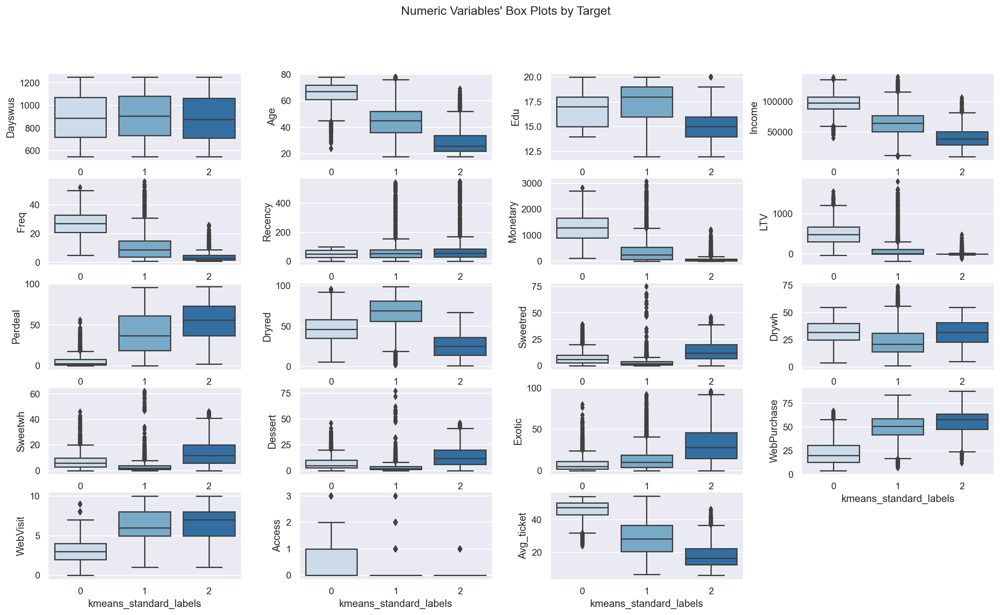

In [104]:
# All Numeric Variables' Box Plots in one figure
sns.set()

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(5, ceil(len(metric_features) / 5), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot:
for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(x=df_final2['kmeans_standard_labels'], y=df_final2[feat], ax=ax,palette="Blues")
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots by Target"
plt.suptitle(title)
plt.subplots_adjust(wspace=0.3)

# Remove the last  graphic
axes.flatten()[-1].remove()

plt.show()